<a href="https://colab.research.google.com/github/Dawoon-Jeong0523/Economic-Complexity/blob/main/Phylogenetic_Tree_Product_IEEE_TEM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
from collections import Counter
import numpy as np
import math
from tqdm.notebook import tqdm
from numpy import dot
from numpy.linalg import norm
import networkx as nx
from numpy import dot
from numpy.linalg import norm
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from networkx.algorithms.community import greedy_modularity_communities
import networkx as nx
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
#from adjustText import adjust_text
from math import pi
from matplotlib.path import Path
from matplotlib.spines import Spine
from matplotlib.transforms import Affine2D
import pydot
from networkx.drawing.nx_pydot import graphviz_layout
from matplotlib import cm
import re

input_directory="/content/drive/MyDrive/Colab Notebooks/Mapping the evolutionary pattern in Mobile Product/Data"
output_directory="/content/drive/MyDrive/Colab Notebooks/Mapping the evolutionary pattern in Mobile Product/Output"

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
class TAXON():
  def __init__(self,id:int, name:str, year:int):
    self.id=id
    self.name=name
    self.year=year
    self.representative=None
    self.genes=None
    self.products=None
    self.genotype=None
    self.ancestor=None
    self.descendant=None
    self.ancestors=None
    self.descendants=None
    self.representative_vector=None

In [ ]:
class TreeNode():
  def __init__(self,input_taxon):
      self.taxon = input_taxon
      self.child = None
      self.pos=(None,None)

In [ ]:
class Tree():
  def __init__(self, root: TreeNode) -> None:
      self.root = root
      self.pos={}
      self.count=0
  def visit(self, node: TreeNode, depth:int) -> None:
      #print("--"*depth, node.taxon.name)
      print("--"*depth, node.taxon.representative)
      self.pos[node]=(depth,self.count*10)
      self.count+=1
  def __DFT_preorderHelp(self, curNode, depth:int)->None:
      #base case
      if curNode ==None:
          return
      self.visit(curNode, depth)

      #child
      for childNode in curNode.child :
          self.__DFT_preorderHelp(childNode, depth+1)


  def DFT_preorder(self) -> None:
      self.__DFT_preorderHelp(self.root, 0)

In [ ]:
import re

class Product:
  def __init__(self,name,year,chromosome):
    self.name=name
    self.year=year
    self.life=1
    self.ancestor=[]
    self.ancestor_list=[]
    self.descendant=[]
    self.color="grey"
    self.chromosome=chromosome
    self.chromosome_vector=0
    self.vt_rate=0
    self.ht_rate=0
    self.mt_rate=0
    self.taxa_name=0

# Functions

In [ ]:
def cosine_similarity(A,B):
  temp_value=dot(A, B)/(norm(A)*norm(B))
  if temp_value:
    return dot(A, B)/(norm(A)*norm(B))
  else:
    return 0

In [ ]:
def jaccard_similarity(A,B):
  return len(set(A).intersection(set(B)))/len(set(A).union(set(B)))

In [ ]:
def Ancestor_Descendant_Single_adjacent_year(descendant_taxon,taxa_list):
  if descendant_taxon.year==min([taxon.year for taxon in taxa_list]):
    return None

  else:
    temp_list=[]
    temp_taxa_list=[]
    for taxon in taxa_list:
      if taxon.year==descendant_taxon.year-1:
        temp_list.append(cosine_similarity(taxon.representative_vector,descendant_taxon.representative_vector))
        #temp_list.append(jaccard_similarity(taxon.representative_vector,descendant_taxon.representative_vector))
        temp_taxa_list.append(taxon)
      else:
        temp_list.append(-1)
        temp_taxa_list.append(taxon)
    return temp_taxa_list[temp_list.index(max(temp_list))]

In [ ]:
# default // input_layout = dot inverse
# input_layout_dict = {
    #'spring': nx.spring_layout(G),
    #'spectral':nx.spectral_layout(G),
    #'shell':nx.shell_layout(G),
    #'circular':nx.circular_layout(G),
    #'kamada_kawai':nx.kamada_kawai_layout(G),
    #'random':nx.random_layout(G),
    #'neato':graphviz_layout(G, prog="neato",root='root'),
    #"twopi":graphviz_layout(G, prog="twopi",root='root'),
    #"dot":graphviz_layout(G, prog="dot",root='root'),
    #"fdp":graphviz_layout(G, prog="fdp",root='root'),
    #"sfdp":graphviz_layout(G, prog="sfdp",root='root'),
    #"circo":graphviz_layout(G, prog="circo",root='root')}

def phylogenetic_tree_Single(input_G,input_Node_list,input_style,input_lw,input_temp_title,name_mode,input_labels_list):
  pos1=graphviz_layout(input_G, prog="dot",root='root')
  temp_pos=pos1
  pos1={}
  for key in list(temp_pos.keys()):
    pos1[key]=[0,0]
    pos1[key][0]=(temp_pos[key][0])
    pos1[key][1]=(-temp_pos[key][1])
  fig = plt.figure(figsize=(50,50))
  ax=plt.subplot(111)
  nx.draw_networkx_nodes(input_G,pos=pos1,node_color="red",alpha=0.5,node_size=0)
  nx.draw_networkx_nodes(input_G,pos=pos1,node_color="red",nodelist=["root"],alpha=1)

  # root node의 후손 연결해주기
  for temp_child in input_Node_list[0].child:
    temp_edge=(input_Node_list[0].taxon.name,temp_child.taxon.name)
    ax.annotate("",
              xy=(pos1[temp_child.taxon.name][0],pos1[temp_child.taxon.name][1]),
              xytext=(pos1[input_Node_list[0].taxon.name][0],pos1[input_Node_list[0].taxon.name][1]),
              arrowprops=dict(
                            arrowstyle="-",
                            lw=input_lw,
                            connectionstyle=input_style,
                            #arrowstyle="wedge",
                            color="red",
                            alpha=0.5
                            )
                  )
  # root node이외의 선조 후손 관계 연결
  for node in input_Node_list:
    if node.taxon.name!="root":
      if node.taxon.descendants:
        for descendant in node.taxon.descendants:
          temp_edge=(node.taxon.name,descendant.name)
          ax.annotate("",
              xy=(pos1[descendant.name][0],pos1[descendant.name][1]),
              xytext=(pos1[node.taxon.name][0],pos1[node.taxon.name][1]),
              arrowprops=dict(
                            arrowstyle="-",
                            lw=input_lw,
                            connectionstyle=input_style,
                            #arrowstyle="wedge",
                            color="red",
                            #alpha=cosine_similarity(node.taxon.representative_vector,descendant.representative_vector)
                            alpha=0.5
                            #alpha=Gower_similarity(node.taxon.representative_vector,descendant.representative_vector,Cat_list)
                            )
                  )

  # year axis
  root_year=int(Node_list[0].taxon.year)
  final_year=int(Node_list[-1].taxon.year)

  year_list=[year for year in range(root_year,final_year+1)]
  temp_y_min=min([pos1[key][1] for key in list(pos1.keys())])
  temp_y_max=max([pos1[key][1] for key in list(pos1.keys())])
  temp_y_list=sorted(list(set([pos1[key][1] for key in list(pos1.keys())])))

  temp_x_min=min([pos1[key][0] for key in list(pos1.keys())])
  temp_x_max=max([pos1[key][0] for key in list(pos1.keys())])
  temp_x_list=sorted(list(set([pos1[key][0] for key in list(pos1.keys())])))


  ax.vlines(temp_x_max*1.1,temp_y_min,temp_y_max)
  for i in range(len(year_list[1:])):
    ax.text(
        temp_x_max*1.1,
        temp_y_list[i+1],
        #temp_y_min+(i+1)*((temp_y_max-temp_y_min)/len(year_list)),
        year_list[i+1],
        fontsize=80
    )

  ax.spines["top"].set_visible(False)
  ax.spines["left"].set_visible(False)
  ax.spines["right"].set_visible(False)
  ax.spines["bottom"].set_visible(False)


  # color bar

  # color bar
  #purple_list=["Micromax X235","Samsung S500","Haier V100","LG C1150","Samsung C400","Samsung C260","Samsung B300","Samsung E215"]
  purple_list=["2003_0","2004_0","2005_2","2006_3","2007_2","2008_1","2009_1","2010_1"]


  # Pseudo Smartphone
  #brown_list=["LG Cookie Lite T300","Celkon C777","Celkon C504","Celkon A9+","Nokia C3-01 Gold Edition"]
  brown_list=["2010_2","2011_0","2011_2","2012_2"]

  #green_list=["Samsung S100",'Motorola A925',"Qtek S100","Motorola A728","HTC P4350","HTC P3350","Samsung i900 Omnia","Samsung B7330 OmniaPRO","Motorola XT720 MOTOROI","Motorola PRO+","Samsung Rugby Smart I847"]
  green_list=["2002_2","2003_2","2004_2","2005_0","2006_1","2007_0","2008_0","2009_0","2010_0","2011_1","2012_0"]

  #blue_list=["Xiaomi Mi CC9e", "Energizer Ultimate U650S", "BLU View 1", "Samsung Galaxy Watch Active2"]
  blue_list=["2019_0","2019_3","2019_1","2019_2"]

  #red_list=['Huawei P9 lite mini', 'Huawei MediaPad M5 8', 'Huawei Watch 2 2018',"Xiaomi Redmi 3s Prime","ZTE nubia N3","Gionee S11"]
  red_list=["2018_0","2017_2","2016_3","2017_1","2018_1","2017_3","2018_2"]

  # labeling
  if name_mode:
    for node in input_Node_list:
      if node.taxon.name!="root":
        ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],node.taxon.name,rotation=30,fontsize=20)

    plt.tight_layout()
    plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_200_wo_label.jpg",dpi=200,transparent=True,bbox_inches="tight")
    plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_300_wo_label.jpg",dpi=300,transparent=True,bbox_inches="tight")

  else:
    # labeling
    for node in input_Node_list:
      if node.taxon.name!="root":
        temp_firm=Counter([product[1:-1].split(" ")[0].strip() for product in node.taxon.products]).most_common(2)
        temp_firm=[x[0] for x in temp_firm]


        temp_list=[]
        temp_sim_list=[]
        for item in node.taxon.products:
          if (item[1:-1].split(" ")[0].strip()) in temp_firm:
            product=[product for product in product_list if product.name==item[1:-1]][0]
            temp_list.append(product)
            temp_sim_list.append(cosine_similarity(product.chromosome_vector,node.taxon.representative_vector))
        temp_label=temp_list[
                              temp_sim_list.index(max(temp_sim_list))
        ]
        temp_label=temp_label.name
        """
        if len(temp_label.split(" "))>=3:
          temp_label=temp_label.split(" ")[0]+"\n"+temp_label.split(" ")[1]+" "+temp_label.split(" ")[2]
        else:
          temp_label=temp_label.split(" ")[0]+"\n"+temp_label.split(" ")[1]
        """
        temp_fontsize=40
        if node.taxon.name in purple_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="purple",fontweight="bold")

        elif node.taxon.name in brown_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="brown",fontweight="bold")
        elif node.taxon.name in green_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="green",fontweight="bold")
        elif node.taxon.name in blue_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="blue",fontweight="bold")
        elif node.taxon.name in red_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="grey",fontweight="bold")

        # 2019 node
        elif node.taxon.year==2019:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold",color="blue")
        elif node.taxon.year==2003:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold",color="black")

        elif not node.taxon.descendants:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold")
        elif len(node.taxon.descendants)>=3:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold")




    nx.draw_networkx_labels(G,pos=pos1,labels={"root":"Root"},font_size=60,font_weight="bold")

  arr1 = ax.arrow(0,0, 0,0, head_width=0, color='purple', length_includes_head=True,label="Pure Feature Phone")
  arr2 = ax.arrow(0,0, 0,0, head_width=0, color='brown', length_includes_head=True,label="Pseudo Smart Phone ")
  arr3 = ax.arrow(0,0, 0,0, head_width=0, color='green', length_includes_head=True,label="Smart Phone")
  arr4 = ax.arrow(0,0, 0,0, head_width=0, color='blue', length_includes_head=True,label="Extant Mobile Product")
  arr5 = ax.arrow(0,0, 0,0, head_width=0, color='grey', length_includes_head=True,label="China Mobile Product")



  ax.legend([arr1,arr2,arr3,arr4,arr5],["Pure Feature Phone Lineage","Pseudo Smart Phone Lineage","Smart Phone Lineage","Extant Mobile Product","China Mobile Product"],loc="upper left",fontsize=80)
  plt.tight_layout()
  plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_200_w_label.jpg",dpi=200,transparent=True,bbox_inches="tight")
  plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_300_w_label.jpg",dpi=300,transparent=True,bbox_inches="tight")

In [ ]:
import re

class Product:
  def __init__(self,name,year,chromosome):
    self.name=name
    self.year=year
    self.life=1
    self.ancestor=[]
    self.ancestor_list=[]
    self.descendant=[]
    self.color="grey"
    self.chromosome=chromosome
    self.chromosome_vector=0
    self.vt_rate=0
    self.ht_rate=0
    self.mt_rate=0
    self.taxa_name=0

In [ ]:
# default // input_layout = dot inverse
# input_layout_dict = {
    #'spring': nx.spring_layout(G),
    #'spectral':nx.spectral_layout(G),
    #'shell':nx.shell_layout(G),
    #'circular':nx.circular_layout(G),
    #'kamada_kawai':nx.kamada_kawai_layout(G),
    #'random':nx.random_layout(G),
    #'neato':graphviz_layout(G, prog="neato",root='root'),
    #"twopi":graphviz_layout(G, prog="twopi",root='root'),
    #"dot":graphviz_layout(G, prog="dot",root='root'),
    #"fdp":graphviz_layout(G, prog="fdp",root='root'),
    #"sfdp":graphviz_layout(G, prog="sfdp",root='root'),
    #"circo":graphviz_layout(G, prog="circo",root='root')}

def phylogenetic_tree_Single(input_G,input_Node_list,input_style,input_lw,input_temp_title,name_mode,input_labels_list):
  pos1=graphviz_layout(input_G, prog="dot",root='root')
  temp_pos=pos1
  pos1={}
  for key in list(temp_pos.keys()):
    pos1[key]=[0,0]
    pos1[key][0]=(temp_pos[key][0])
    pos1[key][1]=(-temp_pos[key][1])
  fig = plt.figure(figsize=(50,50))
  ax=plt.subplot(111)
  nx.draw_networkx_nodes(input_G,pos=pos1,node_color="red",alpha=0.5,node_size=0)
  nx.draw_networkx_nodes(input_G,pos=pos1,node_color="red",nodelist=["root"],alpha=1)

  # root node의 후손 연결해주기
  for temp_child in input_Node_list[0].child:
    temp_edge=(input_Node_list[0].taxon.name,temp_child.taxon.name)
    ax.annotate("",
              xy=(pos1[temp_child.taxon.name][0],pos1[temp_child.taxon.name][1]),
              xytext=(pos1[input_Node_list[0].taxon.name][0],pos1[input_Node_list[0].taxon.name][1]),
              arrowprops=dict(
                            arrowstyle="-",
                            lw=input_lw,
                            connectionstyle=input_style,
                            #arrowstyle="wedge",
                            color="red",
                            alpha=0.5
                            )
                  )
  # root node이외의 선조 후손 관계 연결
  for node in input_Node_list:
    if node.taxon.name!="root":
      if node.taxon.descendants:
        for descendant in node.taxon.descendants:
          temp_edge=(node.taxon.name,descendant.name)
          ax.annotate("",
              xy=(pos1[descendant.name][0],pos1[descendant.name][1]),
              xytext=(pos1[node.taxon.name][0],pos1[node.taxon.name][1]),
              arrowprops=dict(
                            arrowstyle="-",
                            lw=input_lw,
                            connectionstyle=input_style,
                            #arrowstyle="wedge",
                            color="red",
                            #alpha=cosine_similarity(node.taxon.representative_vector,descendant.representative_vector)
                            alpha=0.5
                            #alpha=Gower_similarity(node.taxon.representative_vector,descendant.representative_vector,Cat_list)
                            )
                  )

  # year axis
  root_year=int(Node_list[0].taxon.year)
  final_year=int(Node_list[-1].taxon.year)

  year_list=[year for year in range(root_year,final_year+1)]
  temp_y_min=min([pos1[key][1] for key in list(pos1.keys())])
  temp_y_max=max([pos1[key][1] for key in list(pos1.keys())])
  temp_y_list=sorted(list(set([pos1[key][1] for key in list(pos1.keys())])))

  temp_x_min=min([pos1[key][0] for key in list(pos1.keys())])
  temp_x_max=max([pos1[key][0] for key in list(pos1.keys())])
  temp_x_list=sorted(list(set([pos1[key][0] for key in list(pos1.keys())])))


  ax.vlines(temp_x_max*1.1,temp_y_min,temp_y_max)
  for i in range(len(year_list[1:])):
    ax.text(
        temp_x_max*1.1,
        temp_y_list[i+1],
        #temp_y_min+(i+1)*((temp_y_max-temp_y_min)/len(year_list)),
        year_list[i+1],
        fontsize=80
    )

  ax.spines["top"].set_visible(False)
  ax.spines["left"].set_visible(False)
  ax.spines["right"].set_visible(False)
  ax.spines["bottom"].set_visible(False)


  # color bar

  # color bar
  #purple_list=["Micromax X235","Samsung S500","Haier V100","LG C1150","Samsung C400","Samsung C260","Samsung B300","Samsung E215"]
  purple_list=["2003_0","2004_0","2005_2","2006_3","2007_2","2008_1","2009_1","2010_1"]


  # Pseudo Smartphone
  #brown_list=["LG Cookie Lite T300","Celkon C777","Celkon C504","Celkon A9+","Nokia C3-01 Gold Edition"]
  brown_list=["2010_2","2011_0","2011_2","2012_2"]

  #green_list=["Samsung S100",'Motorola A925',"Qtek S100","Motorola A728","HTC P4350","HTC P3350","Samsung i900 Omnia","Samsung B7330 OmniaPRO","Motorola XT720 MOTOROI","Motorola PRO+","Samsung Rugby Smart I847"]
  green_list=["2002_2","2003_2","2004_2","2005_0","2006_1","2007_0","2008_0","2009_0","2010_0","2011_1","2012_0"]

  #blue_list=["Xiaomi Mi CC9e", "Energizer Ultimate U650S", "BLU View 1", "Samsung Galaxy Watch Active2"]
  blue_list=["2019_0","2019_3","2019_1","2019_2"]

  #red_list=['Huawei P9 lite mini', 'Huawei MediaPad M5 8', 'Huawei Watch 2 2018',"Xiaomi Redmi 3s Prime","ZTE nubia N3","Gionee S11"]
  red_list=["2018_0","2017_2","2016_3","2017_1","2018_1","2017_3","2018_2"]

  # labeling
  if name_mode:
    for node in input_Node_list:
      if node.taxon.name!="root":
        ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],node.taxon.name,rotation=30,fontsize=20)

    plt.tight_layout()
    plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_200_wo_label.jpg",dpi=200,transparent=True,bbox_inches="tight")
    plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_300_wo_label.jpg",dpi=300,transparent=True,bbox_inches="tight")

  else:
    # labeling
    for node in input_Node_list:
      if node.taxon.name!="root":
        temp_firm=Counter([product[1:-1].split(" ")[0].strip() for product in node.taxon.products]).most_common(2)
        temp_firm=[x[0] for x in temp_firm]


        temp_list=[]
        temp_sim_list=[]
        for item in node.taxon.products:
          if (item[1:-1].split(" ")[0].strip()) in temp_firm:
            product=[product for product in product_list if product.name==item[1:-1]][0]
            temp_list.append(product)
            temp_sim_list.append(cosine_similarity(product.chromosome_vector,node.taxon.representative_vector))
        temp_label=temp_list[
                              temp_sim_list.index(max(temp_sim_list))
        ]
        temp_label=temp_label.name
        """
        if len(temp_label.split(" "))>=3:
          temp_label=temp_label.split(" ")[0]+"\n"+temp_label.split(" ")[1]+" "+temp_label.split(" ")[2]
        else:
          temp_label=temp_label.split(" ")[0]+"\n"+temp_label.split(" ")[1]
        """
        temp_fontsize=40
        if node.taxon.name in purple_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="purple",fontweight="bold")

        elif node.taxon.name in brown_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="brown",fontweight="bold")
        elif node.taxon.name in green_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="green",fontweight="bold")
        elif node.taxon.name in blue_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="blue",fontweight="bold")
        elif node.taxon.name in red_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="grey",fontweight="bold")

        # 2019 node
        elif node.taxon.year==2019:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold",color="blue")
        elif node.taxon.year==2003:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold",color="black")

        elif not node.taxon.descendants:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold")
        elif len(node.taxon.descendants)>=3:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold")




    nx.draw_networkx_labels(G,pos=pos1,labels={"root":"Root"},font_size=60,font_weight="bold")

  arr1 = ax.arrow(0,0, 0,0, head_width=0, color='purple', length_includes_head=True,label="Pure Feature Phone")
  arr2 = ax.arrow(0,0, 0,0, head_width=0, color='brown', length_includes_head=True,label="Pseudo Smart Phone ")
  arr3 = ax.arrow(0,0, 0,0, head_width=0, color='green', length_includes_head=True,label="Smart Phone")
  arr4 = ax.arrow(0,0, 0,0, head_width=0, color='blue', length_includes_head=True,label="Extant Mobile Product")
  arr5 = ax.arrow(0,0, 0,0, head_width=0, color='grey', length_includes_head=True,label="China Mobile Product")



  ax.legend([arr1,arr2,arr3,arr4,arr5],["Pure Feature Phone Lineage","Pseudo Smart Phone Lineage","Smart Phone Lineage","Extant Mobile Product","China Mobile Product"],loc="upper left",fontsize=80)
  plt.tight_layout()
  plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_200_w_label.jpg",dpi=200,transparent=True,bbox_inches="tight")
  plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_300_w_label.jpg",dpi=300,transparent=True,bbox_inches="tight")

In [ ]:
# default // input_layout = dot inverse
# input_layout_dict = {
    #'spring': nx.spring_layout(G),
    #'spectral':nx.spectral_layout(G),
    #'shell':nx.shell_layout(G),
    #'circular':nx.circular_layout(G),
    #'kamada_kawai':nx.kamada_kawai_layout(G),
    #'random':nx.random_layout(G),
    #'neato':graphviz_layout(G, prog="neato",root='root'),
    #"twopi":graphviz_layout(G, prog="twopi",root='root'),
    #"dot":graphviz_layout(G, prog="dot",root='root'),
    #"fdp":graphviz_layout(G, prog="fdp",root='root'),
    #"sfdp":graphviz_layout(G, prog="sfdp",root='root'),
    #"circo":graphviz_layout(G, prog="circo",root='root')}

def phylogenetic_tree_Single(input_G,input_Node_list,input_style,input_lw,input_temp_title,name_mode,input_labels_list):
  pos1=graphviz_layout(input_G, prog="dot",root='root')
  temp_pos=pos1
  pos1={}
  for key in list(temp_pos.keys()):
    pos1[key]=[0,0]
    pos1[key][0]=(temp_pos[key][0])
    pos1[key][1]=(-temp_pos[key][1])
  fig = plt.figure(figsize=(50,50))
  ax=plt.subplot(111)
  nx.draw_networkx_nodes(input_G,pos=pos1,node_color="red",alpha=0.5,node_size=0)
  nx.draw_networkx_nodes(input_G,pos=pos1,node_color="red",nodelist=["root"],alpha=1)

  # root node의 후손 연결해주기
  for temp_child in input_Node_list[0].child:
    temp_edge=(input_Node_list[0].taxon.name,temp_child.taxon.name)
    ax.annotate("",
              xy=(pos1[temp_child.taxon.name][0],pos1[temp_child.taxon.name][1]),
              xytext=(pos1[input_Node_list[0].taxon.name][0],pos1[input_Node_list[0].taxon.name][1]),
              arrowprops=dict(
                            arrowstyle="-",
                            lw=input_lw,
                            connectionstyle=input_style,
                            #arrowstyle="wedge",
                            color="red",
                            alpha=0.5
                            )
                  )
  # root node이외의 선조 후손 관계 연결
  for node in input_Node_list:
    if node.taxon.name!="root":
      if node.taxon.descendants:
        for descendant in node.taxon.descendants:
          temp_edge=(node.taxon.name,descendant.name)
          ax.annotate("",
              xy=(pos1[descendant.name][0],pos1[descendant.name][1]),
              xytext=(pos1[node.taxon.name][0],pos1[node.taxon.name][1]),
              arrowprops=dict(
                            arrowstyle="-",
                            lw=input_lw,
                            connectionstyle=input_style,
                            #arrowstyle="wedge",
                            color="red",
                            #alpha=cosine_similarity(node.taxon.representative_vector,descendant.representative_vector)
                            alpha=0.5
                            #alpha=Gower_similarity(node.taxon.representative_vector,descendant.representative_vector,Cat_list)
                            )
                  )

  # year axis
  root_year=int(Node_list[0].taxon.year)
  final_year=int(Node_list[-1].taxon.year)

  year_list=[year for year in range(root_year,final_year+1)]
  temp_y_min=min([pos1[key][1] for key in list(pos1.keys())])
  temp_y_max=max([pos1[key][1] for key in list(pos1.keys())])
  temp_y_list=sorted(list(set([pos1[key][1] for key in list(pos1.keys())])))

  temp_x_min=min([pos1[key][0] for key in list(pos1.keys())])
  temp_x_max=max([pos1[key][0] for key in list(pos1.keys())])
  temp_x_list=sorted(list(set([pos1[key][0] for key in list(pos1.keys())])))


  ax.vlines(temp_x_max*1.1,temp_y_min,temp_y_max)
  for i in range(len(year_list[1:])):
    ax.text(
        temp_x_max*1.1,
        temp_y_list[i+1],
        #temp_y_min+(i+1)*((temp_y_max-temp_y_min)/len(year_list)),
        year_list[i+1],
        fontsize=80
    )

  ax.spines["top"].set_visible(False)
  ax.spines["left"].set_visible(False)
  ax.spines["right"].set_visible(False)
  ax.spines["bottom"].set_visible(False)


  # color bar

  # color bar
  #purple_list=["Micromax X235","Samsung S500","Haier V100","LG C1150","Samsung C400","Samsung C260","Samsung B300","Samsung E215"]
  #purple_list=["2003_0","2004_0","2005_2","2006_3","2007_2","2008_1","2009_1","2010_1"]


  # Pseudo Smartphone
  #brown_list=["LG Cookie Lite T300","Celkon C777","Celkon C504","Celkon A9+","Nokia C3-01 Gold Edition"]
  #brown_list=["2010_2","2011_0","2011_2","2012_2"]

  #green_list=["Samsung S100",'Motorola A925',"Qtek S100","Motorola A728","HTC P4350","HTC P3350","Samsung i900 Omnia","Samsung B7330 OmniaPRO","Motorola XT720 MOTOROI","Motorola PRO+","Samsung Rugby Smart I847"]
  #green_list=["2002_2","2003_2","2004_2","2005_0","2006_1","2007_0","2008_0","2009_0","2010_0","2011_1","2012_0"]

  #blue_list=["Xiaomi Mi CC9e", "Energizer Ultimate U650S", "BLU View 1", "Samsung Galaxy Watch Active2"]
  #blue_list=["2019_0","2019_3","2019_1","2019_2"]

  #red_list=['Huawei P9 lite mini', 'Huawei MediaPad M5 8', 'Huawei Watch 2 2018',"Xiaomi Redmi 3s Prime","ZTE nubia N3","Gionee S11"]
  #red_list=["2018_0","2017_2","2016_3","2017_1","2018_1","2017_3","2018_2"]

  # labeling
  if name_mode:
    for node in input_Node_list:
      if node.taxon.name!="root":
        ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],node.taxon.name,rotation=30,fontsize=20)

    plt.tight_layout()
    plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_200_wo_label.jpg",dpi=200,transparent=True,bbox_inches="tight")
    plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_300_wo_label.jpg",dpi=300,transparent=True,bbox_inches="tight")

  else:
    # labeling
    for node in input_Node_list:
      if node.taxon.name!="root":
        temp_firm=Counter([product[1:-1].split(" ")[0].strip() for product in node.taxon.products]).most_common(2)
        temp_firm=[x[0] for x in temp_firm]


        temp_list=[]
        temp_sim_list=[]
        for item in node.taxon.products:
          if (item[1:-1].split(" ")[0].strip()) in temp_firm:
            product=[product for product in product_list if product.name==item[1:-1]][0]
            temp_list.append(product)
            temp_sim_list.append(cosine_similarity(product.chromosome_vector,node.taxon.representative_vector))
        temp_label=temp_list[
                              temp_sim_list.index(max(temp_sim_list))
        ]
        temp_label=temp_label.name
        temp_fontsize=40
        if node.taxon.name in input_labels_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="black",fontweight="bold")

        """
        if len(temp_label.split(" "))>=3:
          temp_label=temp_label.split(" ")[0]+"\n"+temp_label.split(" ")[1]+" "+temp_label.split(" ")[2]
        else:
          temp_label=temp_label.split(" ")[0]+"\n"+temp_label.split(" ")[1]

        temp_fontsize=40
        if node.taxon.name in purple_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="purple",fontweight="bold")

        elif node.taxon.name in brown_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="brown",fontweight="bold")
        elif node.taxon.name in green_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="green",fontweight="bold")
        elif node.taxon.name in blue_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="blue",fontweight="bold")
        elif node.taxon.name in red_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="grey",fontweight="bold")

        # 2019 node
        elif node.taxon.year==2019:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold",color="blue")
        elif node.taxon.year==2003:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold",color="black")

        elif not node.taxon.descendants:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold")
        elif len(node.taxon.descendants)>=3:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold")
        """



    nx.draw_networkx_labels(G,pos=pos1,labels={"root":"Root"},font_size=60,font_weight="bold")

  #arr1 = ax.arrow(0,0, 0,0, head_width=0, color='purple', length_includes_head=True,label="Pure Feature Phone")
  #arr2 = ax.arrow(0,0, 0,0, head_width=0, color='brown', length_includes_head=True,label="Pseudo Smart Phone ")
  #arr3 = ax.arrow(0,0, 0,0, head_width=0, color='green', length_includes_head=True,label="Smart Phone")
  #arr4 = ax.arrow(0,0, 0,0, head_width=0, color='blue', length_includes_head=True,label="Extant Mobile Product")
  #arr5 = ax.arrow(0,0, 0,0, head_width=0, color='grey', length_includes_head=True,label="China Mobile Product")



  #ax.legend([arr1,arr2,arr3,arr4,arr5],["Pure Feature Phone Lineage","Pseudo Smart Phone Lineage","Smart Phone Lineage","Extant Mobile Product","China Mobile Product"],loc="upper left",fontsize=80)
  plt.tight_layout()
  plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_200_w_label.jpg",dpi=200,transparent=True,bbox_inches="tight")
  plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_300_w_label.jpg",dpi=300,transparent=True,bbox_inches="tight")

# Analysis

In [ ]:
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman'] + plt.rcParams['font.serif']

In [ ]:
#product_df=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/Mapping the evolutionary pattern in Mobile Product/Input Data/Raw_data.csv")

In [ ]:
product_df=pd.read_csv(input_directory+"/210803_output_df_ver2.1.csv")

In [ ]:
product_df.head()

,Unnamed: 0,name,year,info
0,0,Acer Predator 8,2015.0,"[103, 108, 577, 608, 609, 594, 612, 558, 1161,..."
1,1,Acer Iconia Tab A511,2012.0,"[18, 30, 100, 105, 120, 224, 637, 609, 594, 59..."
2,2,alcatel 3T 10,2019.0,"[18, 30, 14, 45, 30, 100, 105, 101, 120, 224, ..."
3,3,alcatel Pop 7 LTE,2016.0,"[18, 30, 14, 45, 30, 100, 105, 101, 120, 224, ..."
4,4,alcatel Pixi 3 (8) LTE,2016.0,"[18, 14, 100, 105, 101, 120, 577, 608, 609, 59..."


In [ ]:
temp_info_list=[]
for i in range(len(product_df)):
  temp_list=[]
  for item in product_df.iloc[i]["info"][1:-1].split(","):
    temp_list.append(int(item.strip()))
  temp_info_list.append(temp_list)

product_df["info"]=temp_info_list
product_df.head()

,Unnamed: 0,name,year,info
0,0,Acer Predator 8,2015.0,"[103, 108, 577, 608, 609, 594, 612, 558, 1161,..."
1,1,Acer Iconia Tab A511,2012.0,"[18, 30, 100, 105, 120, 224, 637, 609, 594, 59..."
2,2,alcatel 3T 10,2019.0,"[18, 30, 14, 45, 30, 100, 105, 101, 120, 224, ..."
3,3,alcatel Pop 7 LTE,2016.0,"[18, 30, 14, 45, 30, 100, 105, 101, 120, 224, ..."
4,4,alcatel Pixi 3 (8) LTE,2016.0,"[18, 14, 100, 105, 101, 120, 577, 608, 609, 59..."


In [ ]:
gene_dictionary_df=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/Mapping the evolutionary pattern in Mobile Product/Data/210803_dictionary_df_ver2.1.csv")
gene_dictionary_df.head()

,Unnamed: 0,Spec,String,index
0,0,Speed,1532,0
1,1,Speed,cat21,1
2,2,Speed,211,2
3,3,Speed,50,3
4,4,Speed,2000,4


In [ ]:
len(gene_dictionary_df)

3888

In [ ]:
gene_dictionary_df[gene_dictionary_df["index"].isin(list(product_df[product_df["name"]=='Apple iPhone 3G']["info"])[0])]

,Unnamed: 0,Spec,String,index
18,18,Speed,hspa,18
100,100,Technology,gsm,100
105,105,Technology,hspa,105
120,120,2G bands,850,120
224,224,3G bands,850,224
558,558,Type,colors,558
594,594,Type,touchscreen,594
609,609,Type,capacitive,609
612,612,Type,16m,612
637,637,Type,tft,637


In [ ]:
set(gene_dictionary_df["Spec"])

{'2G bands',
 '3G bands',
 '4G bands',
 '5G bands',
 'Alarm',
 'Alert types',
 'Bluetooth',
 'Browser',
 'CPU',
 'Call records',
 'Card slot',
 'Charging',
 'Chipset',
 'Colors',
 'Display_etc',
 'Dual',
 'Dual or Triple',
 'EDGE',
 'Features',
 'Features etc',
 'Five',
 'GPRS',
 'GPS',
 'GPU',
 'Games',
 'Internal',
 'Java',
 'Languages',
 'Loudspeaker',
 'Messaging',
 'Music play',
 'NFC',
 'OS',
 'Phonebook',
 'Protection',
 'Quad',
 'Radio',
 'Resolution',
 'Sensors',
 'Single',
 'Size',
 'Speed',
 'Stand-by',
 'Talk time',
 'Technology',
 'Triple',
 'Type',
 'USB',
 'Video',
 'WLAN'}

In [ ]:
gene_dictionary_df[gene_dictionary_df["Spec"]=="Speed"]

,Unnamed: 0,Spec,String,index
0,0,Speed,1532,0
1,1,Speed,cat21,1
2,2,Speed,211,2
3,3,Speed,50,3
4,4,Speed,2000,4
...,...,...,...,...
95,95,Speed,cat22;,95
96,96,Speed,21,96
97,97,Speed,cat7,97
98,98,Speed,hsupa,98


In [ ]:
len(gene_dictionary_df)

3888

In [ ]:
product_list=[]
for i in tqdm(range(len(product_df))):
  temp_name=product_df.loc[i,"name"]
  try:
    temp_year=int(product_df.loc[i,"year"])
  except:
    temp_year=0
  temp_chromosome=product_df.loc[i,"info"]
  # str--> list
  product_list.append(Product(temp_name,temp_year,temp_chromosome))

  temp_vector=np.zeros((len(gene_dictionary_df)))
  for index in product_list[-1].chromosome:
    temp_vector[index]=1

  product_list[-1].chromosome_vector=temp_vector

  0%|          | 0/10213 [00:00<?, ?it/s]

In [ ]:
# 오리지날

cosine_df=pd.read_csv(input_directory+"/Mobile Product_taxa.csv")
vectors=np.load(input_directory+"/Mobile Product_taxa.npy")

df["vector"]=list(vectors)
df.head()
temp_list=[]
for index in range(len(df)):
  temp_list.append(df.loc[index,"products"].split(","))
df["products_list"]=temp_list

df["num_products"]=[len(x) for x in temp_list]

In [ ]:
df[df["year"]==2007]

,id,name,representative,year,vector,genes,products,products_list,num_products
64,64.0,2007_0,HTC P3350,2007.0,"[2.4069451083182885, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[18, 78, 30, 100, 105, 120, 224, 637, 570, 594...","['Eten glofiish X800', 'HTC S730', 'HTC TyTN I...","[['Eten glofiish X800', 'HTC S730', 'HTC TyT...",90
65,65.0,2007_1,Samsung L760,2007.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[87, 100, 107, 637, 599, 558, 717, 1358, 1638,...","['Huawei U121', 'Huawei U120', 'LG KF310', 'LG...","[['Huawei U121', 'Huawei U120', 'LG KF310', ...",41
66,66.0,2007_2,Samsung C260,2007.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[100, 469, 475, 637, 634, 558, 1358, 1565, 159...","['alcatel Mandarina Duck', 'alcatel OT-C707', ...","[['alcatel Mandarina Duck', 'alcatel OT-C707'...",122
67,67.0,2007_3,Samsung E840,2007.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[100, 469, 478, 637, 570, 594, 599, 558, 1358,...","['Asus J502', 'i-mobile 902', 'LG KE590', 'LG ...","[['Asus J502', 'i-mobile 902', 'LG KE590', ...",104


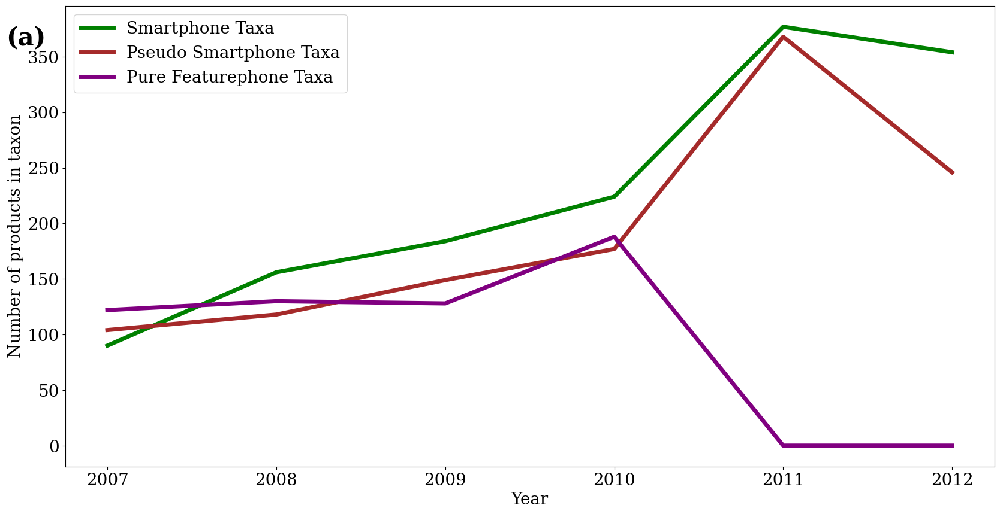

In [ ]:
fig = plt.figure(figsize=(20,10))
ax=plt.subplot(111)

plt.tick_params(axis='both', which='major', labelsize=20)
year_list=[2007,2008,2009,2010,2011,2012]
           #,2013]
temp_All_list_smart=[90,156,184,224,377,354]
                     #,300]
temp_All_list_pseudo=[104,118,149,177,368,246]
                      #$,0]
temp_All_list_pure=[122,130,128,188,0,0]

ax.plot(year_list,temp_All_list_smart,label="Smartphone Taxa",color="green",lw=5)
ax.plot(year_list,temp_All_list_pseudo,label="Pseudo Smartphone Taxa",color="brown",lw=5)
ax.plot(year_list,temp_All_list_pure,label="Pure Featurephone Taxa",color="purple",lw=5)

ax.legend(loc="upper left",fontsize=20)
ax.set_ylabel("Number of products in taxon",fontsize=20)
ax.set_xlabel("Year",fontsize=20)

ax.set_xticks(year_list)
ax.set_xticklabels(year_list,fontsize=20)
ax.text(2006.4,360,"(a)",size=30,weight="bold")
plt.savefig(output_directory+"/220523_All_600_w_label.jpg",dpi=600,transparent=True,bbox_inches="tight")

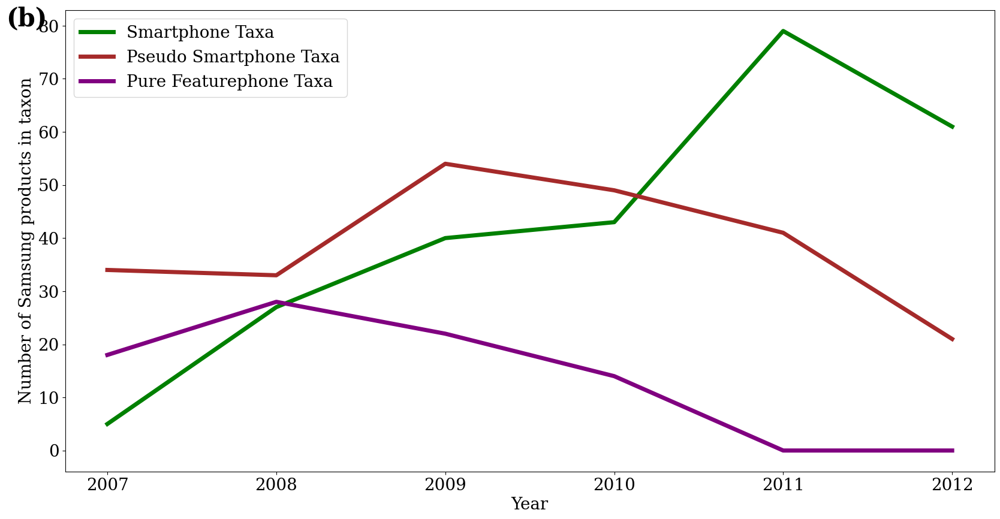

In [ ]:
fig = plt.figure(figsize=(20,10))
ax=plt.subplot(111)
plt.tick_params(axis='both', which='major', labelsize=20)
year_list=[2007,2008,2009,2010,2011,2012]
temp_samsung_list_smart=[5,27,40,43,79,61]
temp_samsung_list_pseudo=[34,33,54,49,41,21]
temp_samsung_list_pure=[18,28,22,14,0,0]

ax.plot(year_list,temp_samsung_list_smart,label="Smartphone Taxa",color="green",lw=5)
ax.plot(year_list,temp_samsung_list_pseudo,label="Pseudo Smartphone Taxa",color="brown",lw=5)
ax.plot(year_list,temp_samsung_list_pure,label="Pure Featurephone Taxa",color="purple",lw=5)

ax.legend(loc="upper left",fontsize=20)
ax.set_ylabel("Number of Samsung products in taxon",fontsize=20)
ax.set_xlabel("Year",fontsize=20)
ax.set_xticks(year_list)
ax.set_xticklabels(year_list)
ax.text(2006.4,80,"(b)",size=30,weight="bold")
plt.savefig(output_directory+"/220523_Samsung_600_w_label.jpg",dpi=600,transparent=True,bbox_inches="tight")

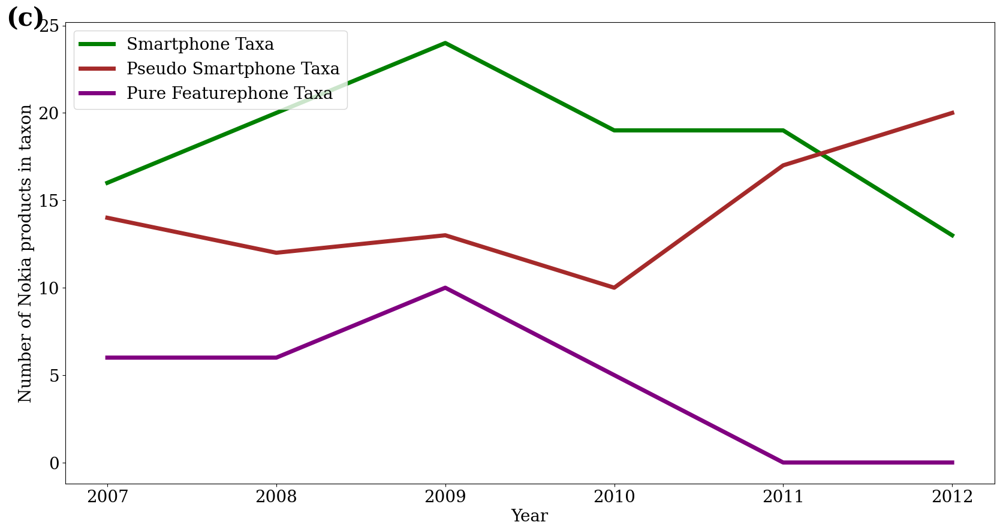

In [ ]:
fig = plt.figure(figsize=(20,10))
ax=plt.subplot(111)
plt.tick_params(axis='both', which='major', labelsize=20)
year_list=[2007,2008,2009,2010,2011,2012]
temp_Nokia_list_smart=[16,20,24,19,19,13]
temp_Nokia_list_pseudo=[14,12,13,10,17,20]
temp_Nokia_list_pure=[6,6,10,5,0,0]

ax.plot(year_list,temp_Nokia_list_smart,label="Smartphone Taxa",color="green",lw=5)
ax.plot(year_list,temp_Nokia_list_pseudo,label="Pseudo Smartphone Taxa",color="brown",lw=5)
ax.plot(year_list,temp_Nokia_list_pure,label="Pure Featurephone Taxa",color="purple",lw=5)

ax.legend(loc="upper left",fontsize=20)
ax.set_ylabel("Number of Nokia products in taxon",fontsize=20)
ax.set_xlabel("Year",fontsize=20)
ax.set_xticks(year_list)
ax.set_xticklabels(year_list)
ax.text(2006.4,25,"(c)",size=30,weight="bold")
plt.savefig(output_directory+"/220523_Nokia_600_w_label.jpg",dpi=600,transparent=True,bbox_inches="tight")

In [ ]:
temp_df=df[df["year"]==2009]
temp_df.reset_index(inplace=True,drop=True)

firm_list=["Samsung","Nokia"]
for index in range(len(temp_df)):
  print(temp_df.loc[index,"name"])
  print(len([x for x in temp_df.loc[index,"products_list"] if "Samsung" in x]))
  print(len([x for x in temp_df.loc[index,"products_list"] if "Nokia" in x]))
  print("---------------------")


2009_0
40
24
---------------------
2009_1
33
10
---------------------
2009_2
54
13
---------------------


In [ ]:
temp_df=df[df["year"]==2010]
temp_df.reset_index(inplace=True,drop=True)

firm_list=["Samsung","Nokia"]
for index in range(len(temp_df)):
  print(temp_df.loc[index,"name"])
  print(len([x for x in temp_df.loc[index,"products_list"] if "Samsung" in x]))
  print(len([x for x in temp_df.loc[index,"products_list"] if "Nokia" in x]))
  print("---------------------")


2010_0
43
19
---------------------
2010_1
14
5
---------------------
2010_2
49
10
---------------------


In [ ]:
temp_df=df[df["year"]==2011]
temp_df.reset_index(inplace=True,drop=True)

firm_list=["Samsung","Nokia"]
for index in range(len(temp_df)):
  print(temp_df.loc[index,"name"])
  print(len([x for x in temp_df.loc[index,"products_list"] if "Samsung" in x]))
  print(len([x for x in temp_df.loc[index,"products_list"] if "Nokia" in x]))
  print("---------------------")


2011_0
0
3
---------------------
2011_1
79
19
---------------------
2011_2
41
14
---------------------


In [ ]:
df[df["year"]==2006]

,id,name,representative,year,vector,genes,products,products_list,num_products
60,60.0,2006_0,Samsung E870,2006.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[100, 469, 475, 637, 599, 558, 1467, 1585, 159...","['Amoi M636', 'Amoi A869', 'Amoi M630', 'Asus ...","[['Amoi M636', 'Amoi A869', 'Amoi M630', 'A...",117
61,61.0,2006_1,HTC P4350,2006.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[87, 100, 107, 637, 570, 594, 634, 558, 1055, ...","['Fujitsu Siemens T830', 'HTC P3600', 'Samsung...","[['Fujitsu Siemens T830', 'HTC P3600', 'Sams...",74
62,62.0,2006_2,Samsung Z550,2006.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[87, 100, 107, 637, 599, 558, 1358, 1645, 1834...","['LG U400', 'LG KU730', 'LG U900', 'Motorola R...","[['LG U400', 'LG KU730', 'LG U900', 'Motoro...",86
63,63.0,2006_3,Samsung C400,2006.0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[100, 469, 475, 637, 599, 558, 759, 1585, 1599...","['LG KG240', 'Philips Xenium 9@9d', 'Telit t65...","[['LG KG240', 'Philips Xenium 9@9d', 'Telit ...",125


In [ ]:
Taxa_list=[]

for i in range(len(df)):
  temp_id=i
  temp_name=df.loc[i,"name"]
  temp_year=df.loc[i,"year"]
  temp_representative=df.loc[i,"representative"]
  temp_representative_vector=df.loc[i,"vector"]
  Taxa_list.append(TAXON(temp_id,temp_name,temp_year))
  Taxa_list[-1].representative=temp_representative
  Taxa_list[-1].representative_vector=temp_representative_vector
  Taxa_list[-1].products=[item.strip() for item in df.loc[i,"products"][1:-1].split(",")]
  #Taxa_list[-1].products=[item.strip() for item in df.loc[i,"product_list"][1:-1].split(",")]

# Matching Evolutionary Relationship
for taxon in tqdm(Taxa_list):
  taxon.ancestor=Ancestor_Descendant_Single_adjacent_year(taxon,Taxa_list)
  #taxon.ancestor=Ancestor_Descendant_Single(taxon,Taxa_list)

for ancestor in Taxa_list:
  temp_list=[]
  for descendant in Taxa_list:
    if descendant.ancestor==ancestor:
      temp_list.append(descendant)
  ancestor.descendants=temp_list

temp_title="GSMArena mobile product paper"

Root=TAXON(-1,"root",1994)
Root.representative="root"
t_root = TreeNode(Root)

Node_list=[]
for taxon in Taxa_list:
  Node_list.append(TreeNode(taxon))

temp_list=[]
for Node in Node_list:
  if Node.taxon.year==1995:
    temp_list.append(Node)

t_root.child=temp_list
Node_list.insert(0,t_root)

for Node in tqdm(Node_list):
  if Node.taxon.year>=1995:
    Node.child=[]
    for descendant in Node.taxon.descendants:
      for Node_j in Node_list:
        if descendant.name==Node_j.taxon.name:
          Node.child.append(Node_j)

myTree = Tree(t_root)
myTree.DFT_preorder()

for node in Node_list:
  myTree.pos[node]=(myTree.pos[node][0],myTree.pos[node][1]-myTree.pos[node][0]*10)

G=nx.DiGraph()
temp_threshold=0
for node in Node_list:
  G.add_node(node.taxon.name)
  for temp_child in node.child:
    G.add_node(temp_child.taxon.name)
    G.add_edge(node.taxon.name,temp_child.taxon.name)

  0%|          | 0/111 [00:00<?, ?it/s]

  0%|          | 0/112 [00:00<?, ?it/s]

 root
-- Ericsson GA 318
---- Bosch Com 738
------ Sony CMD Z1 plus
-------- Motorola StarTAC 130
---------- Maxon MX-3204
------------ Philips Genie 2000
-------------- Sagem MW 3040
-------------- Panasonic GD75
-------------- Ericsson R600
-------------- Sendo P200
-------------- NEC DB6000
------------ Sony CMD Z5
-------------- Sony CMD J7
------------ Motorola Talkabout T2288
---------- Samsung SGH-2100
------------ Samsung A100
-------------- Motorola V66
---------------- Nokia 6510
-------------- Samsung Q105
---------------- Motorola C300
------------------ Siemens Xelibri 4
---------------- Motorola C336
---------------- Samsung S100
------------------ Samsung S500
-------------------- Haier V100
---------------------- LG C1150
------------------------ Samsung C400
-------------------------- Samsung C260
---------------------------- Samsung B300
------------------------------ Samsung E215
-------------------------------- Micromax X235
------------------ Motorola V303
--------

In [ ]:
Taxa_list=[]

for i in range(len(df)):
  temp_id=i
  temp_name=df.loc[i,"name"]
  temp_year=df.loc[i,"year"]
  temp_representative=df.loc[i,"representative"]
  temp_representative_vector=df.loc[i,"vector"]
  Taxa_list.append(TAXON(temp_id,temp_name,temp_year))
  Taxa_list[-1].representative=temp_representative
  Taxa_list[-1].representative_vector=temp_representative_vector
  Taxa_list[-1].products=[item.strip() for item in df.loc[i,"products"][1:-1].split(",")]
  #Taxa_list[-1].products=[item.strip() for item in df.loc[i,"product_list"][1:-1].split(",")]

# Matching Evolutionary Relationship
for taxon in tqdm(Taxa_list):
  taxon.ancestor=Ancestor_Descendant_Single_adjacent_year(taxon,Taxa_list)
  #taxon.ancestor=Ancestor_Descendant_Single(taxon,Taxa_list)

for ancestor in Taxa_list:
  temp_list=[]
  for descendant in Taxa_list:
    if descendant.ancestor==ancestor:
      temp_list.append(descendant)
  ancestor.descendants=temp_list

  0%|          | 0/111 [00:00<?, ?it/s]

In [ ]:
temp_title="GSMArena mobile product paper"

Root=TAXON(-1,"root",1994)
Root.representative="root"
t_root = TreeNode(Root)

Node_list=[]
for taxon in Taxa_list:
  Node_list.append(TreeNode(taxon))

temp_list=[]
for Node in Node_list:
  if Node.taxon.year==1995:
    temp_list.append(Node)

t_root.child=temp_list
Node_list.insert(0,t_root)

for Node in tqdm(Node_list):
  if Node.taxon.year>=1995:
    Node.child=[]
    for descendant in Node.taxon.descendants:
      for Node_j in Node_list:
        if descendant.name==Node_j.taxon.name:
          Node.child.append(Node_j)

myTree = Tree(t_root)
myTree.DFT_preorder()

for node in Node_list:
  myTree.pos[node]=(myTree.pos[node][0],myTree.pos[node][1]-myTree.pos[node][0]*10)

  0%|          | 0/112 [00:00<?, ?it/s]

 root
-- Ericsson GA 318
---- Bosch Com 738
------ Sony CMD Z1 plus
-------- Motorola StarTAC 130
---------- Maxon MX-3204
------------ Philips Genie 2000
-------------- Sagem MW 3040
-------------- Panasonic GD75
-------------- Ericsson R600
-------------- Sendo P200
-------------- NEC DB6000
------------ Sony CMD Z5
-------------- Sony CMD J7
------------ Motorola Talkabout T2288
---------- Samsung SGH-2100
------------ Samsung A100
-------------- Motorola V66
---------------- Nokia 6510
-------------- Samsung Q105
---------------- Motorola C300
------------------ Siemens Xelibri 4
---------------- Motorola C336
---------------- Samsung S100
------------------ Samsung S500
-------------------- Haier V100
---------------------- LG C1150
------------------------ Samsung C400
-------------------------- Samsung C260
---------------------------- Samsung B300
------------------------------ Samsung E215
-------------------------------- Micromax X235
------------------ Motorola V303
--------

In [ ]:
G=nx.DiGraph()
temp_threshold=0
for node in Node_list:
  G.add_node(node.taxon.name)
  for temp_child in node.child:
    G.add_node(temp_child.taxon.name)
    G.add_edge(node.taxon.name,temp_child.taxon.name)

# Original

In [ ]:
import matplotlib.pyplot as plt
import networkx as nx
from collections import Counter

def phylogenetic_tree_Single(input_G, input_Node_list, input_style, input_lw, input_temp_title, name_mode, input_labels_list):
    pos1 = graphviz_layout(input_G, prog="dot", root='root')
    temp_pos = pos1
    pos1 = {}
    for key in list(temp_pos.keys()):
        pos1[key] = [0, 0]
        pos1[key][0] = (temp_pos[key][0])
        pos1[key][1] = (-temp_pos[key][1])
    fig = plt.figure(figsize=(50, 50))
    ax = plt.subplot(111)
    nx.draw_networkx_nodes(input_G, pos=pos1, node_color="red", alpha=0.5, node_size=0)
    nx.draw_networkx_nodes(input_G, pos=pos1, node_color="red", nodelist=["root"], alpha=1)

    # Connect root node with its descendants
    for temp_child in input_Node_list[0].child:
        temp_edge = (input_Node_list[0].taxon.name, temp_child.taxon.name)
        ax.annotate("",
                    xy=(pos1[temp_child.taxon.name][0], pos1[temp_child.taxon.name][1]),
                    xytext=(pos1[input_Node_list[0].taxon.name][0], pos1[input_Node_list[0].taxon.name][1]),
                    arrowprops=dict(
                        arrowstyle="-",
                        lw=input_lw,
                        connectionstyle=input_style,
                        color="red",
                        alpha=0.5
                    )
                    )

    # Connect other ancestor-descendant relationships
    for node in input_Node_list:
        if node.taxon.name != "root":
            if node.taxon.descendants:
                for descendant in node.taxon.descendants:
                    temp_edge = (node.taxon.name, descendant.name)
                    ax.annotate("",
                                xy=(pos1[descendant.name][0], pos1[descendant.name][1]),
                                xytext=(pos1[node.taxon.name][0], pos1[node.taxon.name][1]),
                                arrowprops=dict(
                                    arrowstyle="-",
                                    lw=input_lw,
                                    connectionstyle=input_style,
                                    color="red",
                                    alpha=0.5
                                )
                                )

    # Year axis
    root_year = int(input_Node_list[0].taxon.year)
    final_year = int(input_Node_list[-1].taxon.year)
    year_list = [year for year in range(root_year, final_year + 1)]
    temp_y_min = min([pos1[key][1] for key in list(pos1.keys())])
    temp_y_max = max([pos1[key][1] for key in list(pos1.keys())])
    temp_y_list = sorted(list(set([pos1[key][1] for key in list(pos1.keys())])))
    temp_x_min = min([pos1[key][0] for key in list(pos1.keys())])
    temp_x_max = max([pos1[key][0] for key in list(pos1.keys())])
    temp_x_list = sorted(list(set([pos1[key][0] for key in list(pos1.keys())])))

    ax.vlines(temp_x_max * 1.1, temp_y_min, temp_y_max)
    for i in range(len(year_list[1:])):
        ax.text(
            temp_x_max * 1.1,
            temp_y_list[i + 1],
            year_list[i + 1],
            fontsize=80
        )

    ax.spines["top"].set_visible(False)
    ax.spines["left"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.spines["bottom"].set_visible(False)

    # Color lists
    purple_list = ["2003_0", "2004_0", "2005_2", "2006_3", "2007_2", "2008_1", "2009_1", "2010_1", "2003_1", "2005_1"]
    brown_list = ["2010_2", "2011_0", "2011_2", "2012_2", "2007_3", "2008_2", "2009_2"]
    green_list = ["2004_2", "2005_0", "2006_1", "2007_0", "2008_0", "2009_0", "2010_0", "2011_1", "2012_0"]
    blue_list = ["2019_0", "2019_3", "2019_1", "2019_2"]
    red_list = ["2018_0", "2017_2", "2016_3", "2017_1", "2018_1", "2017_3", "2018_2"]

    # Labeling
    if name_mode:
        for node in input_Node_list:
            if node.taxon.name != "root":
                ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], node.taxon.name, rotation=30, fontsize=20)

        plt.tight_layout()
        plt.savefig(f"{output_directory}/{input_temp_title}_Phylogenetic_Tree_dot_inverse_200_wo_label.jpg", dpi=200, transparent=True, bbox_inches="tight")
        plt.savefig(f"{output_directory}/{input_temp_title}_Phylogenetic_Tree_dot_inverse_300_wo_label.jpg", dpi=300, transparent=True, bbox_inches="tight")

    else:
        for node in input_Node_list:
            if node.taxon.name != "root":
                temp_firm = Counter([product[1:-1].split(" ")[0].strip() for product in node.taxon.products]).most_common(2)
                temp_firm = [x[0] for x in temp_firm]

                temp_list = []
                temp_sim_list = []
                for item in node.taxon.products:
                    if (item[1:-1].split(" ")[0].strip()) in temp_firm:
                        product = [product for product in product_list if product.name == item[1:-1]][0]
                        temp_list.append(product)
                        temp_sim_list.append(cosine_similarity(product.chromosome_vector, node.taxon.representative_vector))
                temp_label = temp_list[
                    temp_sim_list.index(max(temp_sim_list))
                ]
                temp_label = temp_label.name

                if len(temp_label.split(" ")) >= 3:
                    temp_label = temp_label.split(" ")[0] + "\n" + temp_label.split(" ")[1] + " " + temp_label.split(" ")[2]
                else:
                    temp_label = temp_label.split(" ")[0] + "\n" + temp_label.split(" ")[1]

                temp_fontsize = 40
                if node.taxon.name in purple_list:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, color="purple", fontweight="bold")
                elif node.taxon.name in brown_list:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, color="brown", fontweight="bold")
                elif node.taxon.name in green_list:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, color="green", fontweight="bold")
                elif node.taxon.name in blue_list:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, color="blue", fontweight="bold")
                elif node.taxon.name in red_list:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, color="grey", fontweight="bold")
                elif node.taxon.year == 2019:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, fontweight="bold", color="blue")
                elif node.taxon.year == 2003:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, fontweight="bold", color="black")
                elif not node.taxon.descendants:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, fontweight="bold")
                elif len(node.taxon.descendants) >= 3:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, fontweight="bold")

        nx.draw_networkx_labels(input_G, pos=pos1, labels={"root": "Root"}, font_size=60, font_weight="bold")

    arr1 = ax.arrow(0, 0, 0, 0, head_width=0, color='purple', length_includes_head=True, label="Pure Featurephone Taxa")
    arr2 = ax.arrow(0, 0, 0, 0, head_width=0, color='brown', length_includes_head=True, label="Pseudo Smartphone Taxa")
    arr3 = ax.arrow(0, 0, 0, 0, head_width=0, color='green', length_includes_head=True, label="Smartphone Taxa")
    arr4 = ax.arrow(0, 0, 0, 0, head_width=0, color='blue', length_includes_head=True, label="Extant mobile product Taxa")
    arr5 = ax.arrow(0, 0, 0, 0, head_width=0, color='grey', length_includes_head=True, label="Chinese Mobile Product as representative product")

    ax.legend([arr1, arr2, arr3, arr4, arr5], ["Pure Featurephone Taxa", "Pseudo Smartphone Taxa", "Smartphone Taxa", "Extant mobile product Taxa", "Chinese Mobile Product \nas a representative product"], loc="upper left", fontsize=80)
    plt.tight_layout()
    plt.savefig(f"{output_directory}/{input_temp_title}_Phylogenetic_Tree_dot_inverse_200_w_label.jpg", dpi=200, transparent=True, bbox_inches="tight")
    plt.savefig(f"{output_directory}/{input_temp_title}_Phylogenetic_Tree_dot_inverse_600_w_label.jpg", dpi=600, transparent=True, bbox_inches="tight")


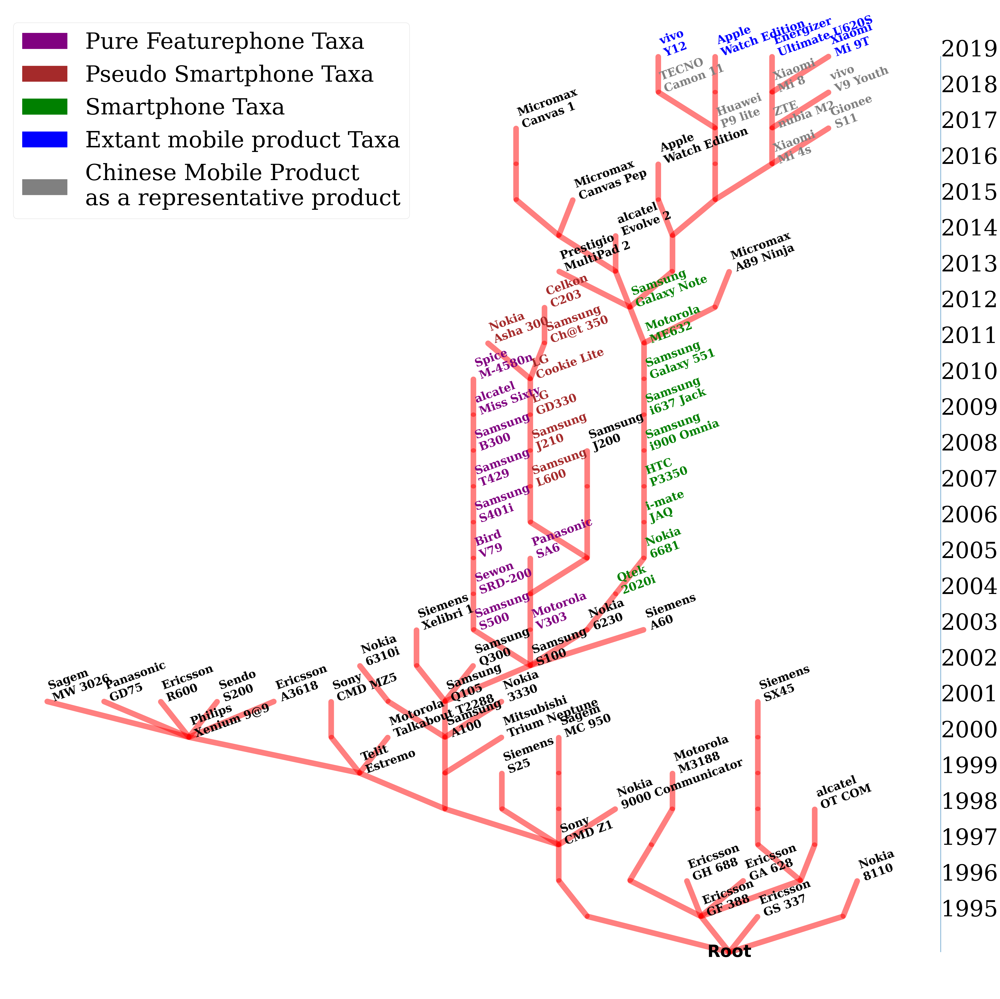

In [ ]:
phylogenetic_tree_Single(G,Node_list,"arc3",20,"220506_Mobile Product paper_original_wlabel",False,[taxon.name for taxon in Taxa_list])

In [ ]:
def phylogenetic_tree_Single(input_G, input_Node_list, input_style, input_lw, input_temp_title, name_mode, input_labels_list):
    pos1 = graphviz_layout(input_G, prog="dot", root='root')
    temp_pos = pos1
    pos1 = {}
    for key in list(temp_pos.keys()):
        pos1[key] = [0, 0]
        pos1[key][0] = (temp_pos[key][0])
        pos1[key][1] = (-temp_pos[key][1])
    fig = plt.figure(figsize=(50, 50))
    ax = plt.subplot(111)

    # Rotate positions by 90 degrees (year on x-axis)
    for key in pos1:
        pos1[key] = [pos1[key][1], -pos1[key][0]]

    nx.draw_networkx_nodes(input_G, pos=pos1, node_color="red", alpha=0.5, node_size=0)
    nx.draw_networkx_nodes(input_G, pos=pos1, node_color="red", nodelist=["root"], alpha=1)

    # Connect root node with its descendants
    root_y = pos1["root"][1]
    for temp_child in input_Node_list[0].child:
        connectionstyle = "arc3,rad=0.2" if pos1[temp_child.taxon.name][1] < root_y else "arc3,rad=-0.2"
        ax.annotate("",
                    xy=(pos1[temp_child.taxon.name][0], pos1[temp_child.taxon.name][1]),
                    xytext=(pos1[input_Node_list[0].taxon.name][0], pos1[input_Node_list[0].taxon.name][1]),
                    arrowprops=dict(
                        arrowstyle="-",
                        lw=input_lw,
                        connectionstyle=connectionstyle,
                        color="red",
                        alpha=0.5
                    )
                    )

    # Connect other ancestor-descendant relationships
    for node in input_Node_list:
        if node.taxon.name != "root":
            if node.taxon.descendants:
                for descendant in node.taxon.descendants:
                    connectionstyle = "arc3,rad=0.2" if pos1[descendant.name][1] < pos1[node.taxon.name][1] else "arc3,rad=-0.2"
                    ax.annotate("",
                                xy=(pos1[descendant.name][0], pos1[descendant.name][1]),
                                xytext=(pos1[node.taxon.name][0], pos1[node.taxon.name][1]),
                                arrowprops=dict(
                                    arrowstyle="-",
                                    lw=input_lw,
                                    connectionstyle=connectionstyle,
                                    color="red",
                                    alpha=0.5
                                )
                                )

    # Year axis on the bottom
    root_year = int(input_Node_list[0].taxon.year)
    final_year = int(input_Node_list[-1].taxon.year)
    year_list = [year for year in range(root_year, final_year + 1)]
    temp_y_min = min([pos1[key][1] for key in list(pos1.keys())])
    temp_y_max = max([pos1[key][1] for key in list(pos1.keys())])
    temp_y_list = sorted(list(set([pos1[key][1] for key in list(pos1.keys())])))
    temp_x_min = min([pos1[key][0] for key in list(pos1.keys())])
    temp_x_max = max([pos1[key][0] for key in list(pos1.keys())])
    temp_x_list = sorted(list(set([pos1[key][0] for key in list(pos1.keys())])))

    for i in range(len(year_list)):
        ax.text(
            temp_x_list[i],
            temp_y_min-100,  # Adjust the position if necessary
            str(year_list[i]),
            fontsize=40,
            va='center',
            rotation = 90
        )

    ax.spines["top"].set_visible(False)
    ax.spines["left"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.spines["bottom"].set_visible(False)

    # Color lists
    purple_list = ["2003_0", "2004_0", "2005_2", "2006_3", "2007_2", "2008_1", "2009_1", "2010_1", "2003_1", "2005_1"]
    brown_list = ["2010_2", "2011_0", "2011_2", "2012_2", "2007_3", "2008_2", "2009_2"]
    green_list = ["2004_2", "2005_0", "2006_1", "2007_0", "2008_0", "2009_0", "2010_0", "2011_1", "2012_0"]
    blue_list = ["2019_0", "2019_3", "2019_1", "2019_2"]
    red_list = ["2018_0", "2017_2", "2016_3", "2017_1", "2018_1", "2017_3", "2018_2"]

    # Labeling
    if name_mode:
        for node in input_Node_list:
            if node.taxon.name != "root":
                ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], node.taxon.name, rotation=30, fontsize=10)

        plt.tight_layout()
        plt.savefig(f"{output_directory}/{input_temp_title}_Phylogenetic_Tree_dot_inverse_200_wo_label.jpg", dpi=200, transparent=True, bbox_inches="tight")
        plt.savefig(f"{output_directory}/{input_temp_title}_Phylogenetic_Tree_dot_inverse_300_wo_label.jpg", dpi=300, transparent=True, bbox_inches="tight")

    else:
        for node in input_Node_list:
            if node.taxon.name != "root":
                temp_firm = Counter([product[1:-1].split(" ")[0].strip() for product in node.taxon.products]).most_common(2)
                temp_firm = [x[0] for x in temp_firm]

                temp_list = []
                temp_sim_list = []
                for item in node.taxon.products:
                    if (item[1:-1].split(" ")[0].strip()) in temp_firm:
                        product = [product for product in product_list if product.name == item[1:-1]][0]
                        temp_list.append(product)
                        temp_sim_list.append(cosine_similarity(product.chromosome_vector, node.taxon.representative_vector))
                temp_label = temp_list[
                    temp_sim_list.index(max(temp_sim_list))
                ]
                temp_label = temp_label.name

                if len(temp_label.split(" ")) >= 3:
                    temp_label = temp_label.split(" ")[0] + "\n" + temp_label.split(" ")[1] + " " + temp_label.split(" ")[2]
                else:
                    temp_label = temp_label.split(" ")[0] + "\n" + temp_label.split(" ")[1]

                temp_fontsize = 30
                if node.taxon.name in purple_list:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, color="purple", fontweight="bold")
                elif node.taxon.name in brown_list:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, color="brown", fontweight="bold")
                elif node.taxon.name in green_list:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, color="green", fontweight="bold")
                elif node.taxon.name in blue_list:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, color="blue", fontweight="bold")
                elif node.taxon.name in red_list:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, color="grey", fontweight="bold")
                elif node.taxon.year == 2019:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, fontweight="bold", color="blue")
                elif node.taxon.year == 2003:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, fontweight="bold", color="black")
                elif not node.taxon.descendants:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, fontweight="bold")
                elif len(node.taxon.descendants) >= 3:
                    ax.text(pos1[node.taxon.name][0], pos1[node.taxon.name][1], temp_label, rotation=20, fontsize=temp_fontsize, fontweight="bold")

        nx.draw_networkx_labels(input_G, pos=pos1, labels={"root": "Root"}, font_size=60, font_weight="bold")

    arr1 = ax.arrow(0, 0, 0, 0, head_width=0, color='purple', length_includes_head=True, label="Pure Featurephone Taxa")
    arr2 = ax.arrow(0, 0, 0, 0, head_width=0, color='brown', length_includes_head=True, label="Pseudo Smartphone Taxa")
    arr3 = ax.arrow(0, 0, 0, 0, head_width=0, color='green', length_includes_head=True, label="Smartphone Taxa")
    arr4 = ax.arrow(0, 0, 0, 0, head_width=0, color='blue', length_includes_head=True, label="Extant mobile product Taxa")
    arr5 = ax.arrow(0, 0, 0, 0, head_width=0, color='grey', length_includes_head=True, label="Chinese Mobile Product as representative product")

    ax.legend([arr1, arr2, arr3, arr4, arr5], ["Pure Featurephone Taxa", "Pseudo Smartphone Taxa", "Smartphone Taxa", "Extant mobile product Taxa", "Chinese Mobile Product \nas a representative product"], loc="upper right", fontsize=80)
    plt.tight_layout()
    plt.savefig(f"{output_directory}/{input_temp_title}_Phylogenetic_Tree_dot_inverse_200_w_label.jpg", dpi=200, transparent=True, bbox_inches="tight")
    plt.savefig(f"{output_directory}/{input_temp_title}_Phylogenetic_Tree_dot_inverse_600_w_label.jpg", dpi=600, transparent=True, bbox_inches="tight")


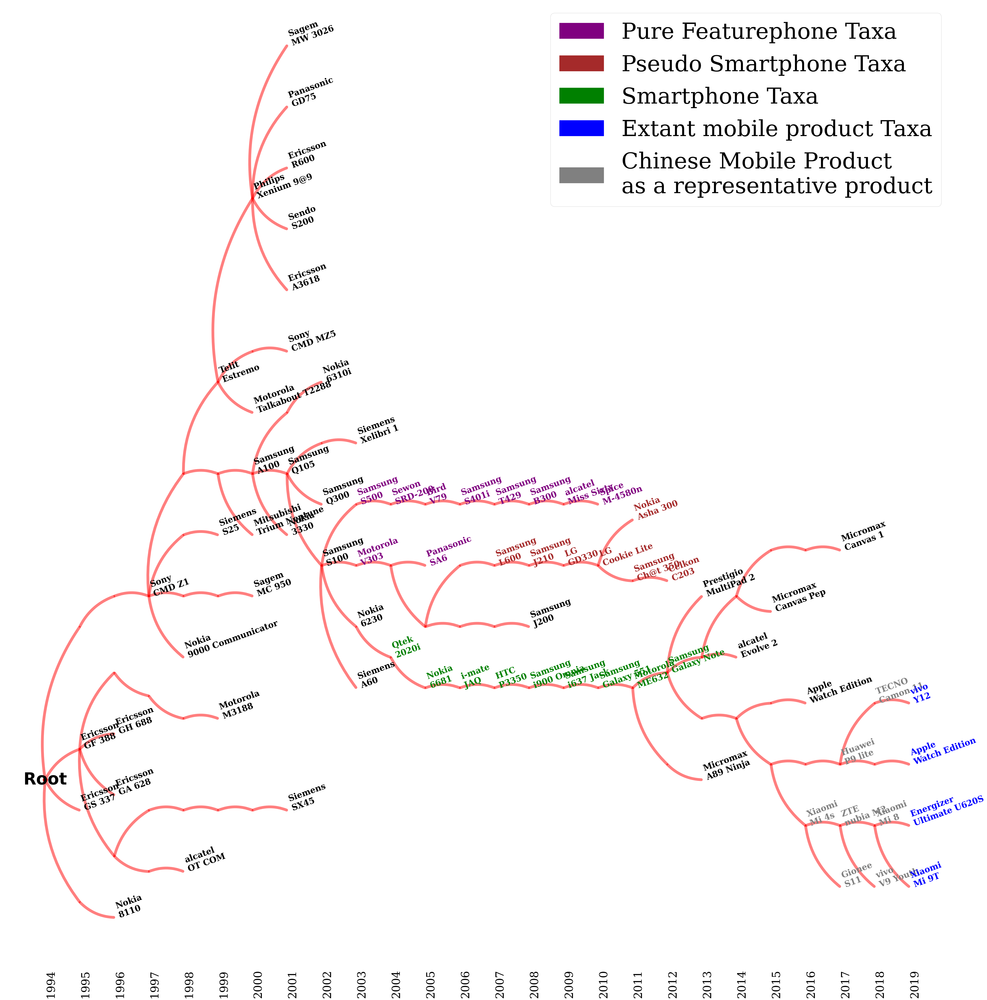

In [ ]:
phylogenetic_tree_Single(G,Node_list,"arc3, rad=0.2",10,"220506_Mobile Product paper_original_wlabel_left",False,[taxon.name for taxon in Taxa_list])

In [ ]:
# default // input_layout = dot inverse
# input_layout_dict = {
    #'spring': nx.spring_layout(G),
    #'spectral':nx.spectral_layout(G),
    #'shell':nx.shell_layout(G),
    #'circular':nx.circular_layout(G),
    #'kamada_kawai':nx.kamada_kawai_layout(G),
    #'random':nx.random_layout(G),
    #'neato':graphviz_layout(G, prog="neato",root='root'),
    #"twopi":graphviz_layout(G, prog="twopi",root='root'),
    #"dot":graphviz_layout(G, prog="dot",root='root'),
    #"fdp":graphviz_layout(G, prog="fdp",root='root'),
    #"sfdp":graphviz_layout(G, prog="sfdp",root='root'),
    #"circo":graphviz_layout(G, prog="circo",root='root')}

def phylogenetic_tree_Single_firm(input_G,input_Node_list,input_style,input_lw,input_temp_title,name_mode,input_firm):
  pos1=graphviz_layout(input_G, prog="dot",root='root')
  temp_pos=pos1
  pos1={}
  for key in list(temp_pos.keys()):
    pos1[key]=[0,0]
    pos1[key][0]=(temp_pos[key][0])
    pos1[key][1]=(-temp_pos[key][1])
  fig = plt.figure(figsize=(50,50))
  ax=plt.subplot(111)
  nx.draw_networkx_nodes(input_G,pos=pos1,node_color="red",alpha=0.5,node_size=0)
  nx.draw_networkx_nodes(input_G,pos=pos1,node_color="red",nodelist=["root"],alpha=1)

  # root node의 후손 연결해주기
  for temp_child in input_Node_list[0].child:
    temp_edge=(input_Node_list[0].taxon.name,temp_child.taxon.name)
    ax.annotate("",
              xy=(pos1[temp_child.taxon.name][0],pos1[temp_child.taxon.name][1]),
              xytext=(pos1[input_Node_list[0].taxon.name][0],pos1[input_Node_list[0].taxon.name][1]),
              arrowprops=dict(
                            arrowstyle="-",
                            lw=input_lw,
                            connectionstyle=input_style,
                            #arrowstyle="wedge",
                            color="red",
                            alpha=0.5
                            )
                  )
    """
    ax.plot([pos1[input_Node_list[0].taxon.name][0],pos1[temp_child.taxon.name][0]],
                  [pos1[input_Node_list[0].taxon.name][1],pos1[temp_child.taxon.name][1]],
                  color="red")

    nx.draw_networkx_edges(input_G,
                           pos=pos1,
                           alpha=1,
                           edgelist=[temp_edge],
                           width=20,
                           arrows=False,
                           edge_color="red")
    """

  # root node이외의 선조 후손 관계 연결
  for node in input_Node_list:
    if node.taxon.name!="root":
      if node.taxon.descendants:
        for descendant in node.taxon.descendants:
          temp_edge=(node.taxon.name,descendant.name)
          ax.annotate("",
              xy=(pos1[descendant.name][0],pos1[descendant.name][1]),
              xytext=(pos1[node.taxon.name][0],pos1[node.taxon.name][1]),
              arrowprops=dict(
                            arrowstyle="-",
                            lw=input_lw,
                            connectionstyle=input_style,
                            #arrowstyle="wedge",
                            color="red",
                            #alpha=cosine_similarity(node.taxon.representative_vector,descendant.representative_vector)
                            alpha=0.5
                            #alpha=Gower_similarity(node.taxon.representative_vector,descendant.representative_vector,Cat_list)
                            )
                  )

          """
          nx.draw_networkx_edges(input_G,
                             pos=pos1,
                             #alpha=cosine_similarity(node.taxon.representative_vector,descendant.representative_vector),
                             alpha=jaccard_similarity(node.taxon.representative_vector,descendant.representative_vector),
                             edgelist=[temp_edge],
                             width=20,
                             arrows=False,
                             connectionstyle="arc3,rad=1",
                             #arrowstyle="wedge",
                             edge_color="red",
                             node_size=0)
          """


  # year axis
  root_year=int(Node_list[0].taxon.year)
  final_year=int(Node_list[-1].taxon.year)

  year_list=[year for year in range(root_year,final_year+1)]
  temp_y_min=min([pos1[key][1] for key in list(pos1.keys())])
  temp_y_max=max([pos1[key][1] for key in list(pos1.keys())])
  temp_y_list=sorted(list(set([pos1[key][1] for key in list(pos1.keys())])))

  temp_x_min=min([pos1[key][0] for key in list(pos1.keys())])
  temp_x_max=max([pos1[key][0] for key in list(pos1.keys())])
  temp_x_list=sorted(list(set([pos1[key][0] for key in list(pos1.keys())])))


  ax.vlines(temp_x_max*1.1,temp_y_min,temp_y_max)
  for i in range(len(year_list[1:])):
    ax.text(
        temp_x_max*1.1,
        temp_y_list[i+1],
        #temp_y_min+(i+1)*((temp_y_max-temp_y_min)/len(year_list)),
        year_list[i+1],
        fontsize=80
    )

  ax.spines["top"].set_visible(False)
  ax.spines["left"].set_visible(False)
  ax.spines["right"].set_visible(False)
  ax.spines["bottom"].set_visible(False)


  # color bar

  texts=[]
  # labeling
  if name_mode:
    for node in input_Node_list:
      if node.taxon.name!="root":
        ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],node.taxon.name,rotation=40,fontsize=20)

    plt.tight_layout()
    plt.savefig(output_directory+"/"+temp_title+"_Phylogenetic Tree dot inverse_200_wo_label.jpg",dpi=200,transparent=True,bbox_inches="tight")
    plt.savefig(output_directory+"/"+temp_title+"_Phylogenetic Tree dot inverse_300_wo_label.jpg",dpi=300,transparent=True,bbox_inches="tight")

  else:
    # labeling
    for node in input_Node_list:
      if node.taxon.name!="root":
        temp_list=[]
        temp_sim_list=[]
        for item in node.taxon.products:
          product=[product for product in product_list if product.name==item[1:-1]][0]
          if input_firm in product.name:
            temp_list.append(product)
            temp_sim_list.append(cosine_similarity(product.chromosome_vector,node.taxon.representative_vector))
        #if len(temp_list)>0.1*len(node.taxon.products):
        if len(temp_list)>=1:
          temp_label=temp_list[
                                temp_sim_list.index(max(temp_sim_list))
          ]
          #print(node.taxon.name)
          #print(dict(zip([item.name for item in temp_list],temp_sim_list)))
          #print(temp_sim_list)
          #print("---------------------------------------------------------------------")
          temp_label=re.sub(temp_label.name.split(" ")[0],"",temp_label.name)

          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=10,fontsize=40,fontweight="bold")

    nx.draw_networkx_labels(G,pos=pos1,labels={"root":"Root"},font_size=60,font_weight="bold")
  ax.text(0,0,input_firm,fontsize=150)

  #,arrowprops=dict(arrowstyle='->', color='grey',lw=5)
  #adjust_text(texts,only_move={"points":"y"})
  plt.tight_layout()
  plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_200_w_label.jpg",dpi=200,transparent=True,bbox_inches="tight")
  plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_600_w_label.jpg",dpi=600,transparent=True,bbox_inches="tight")

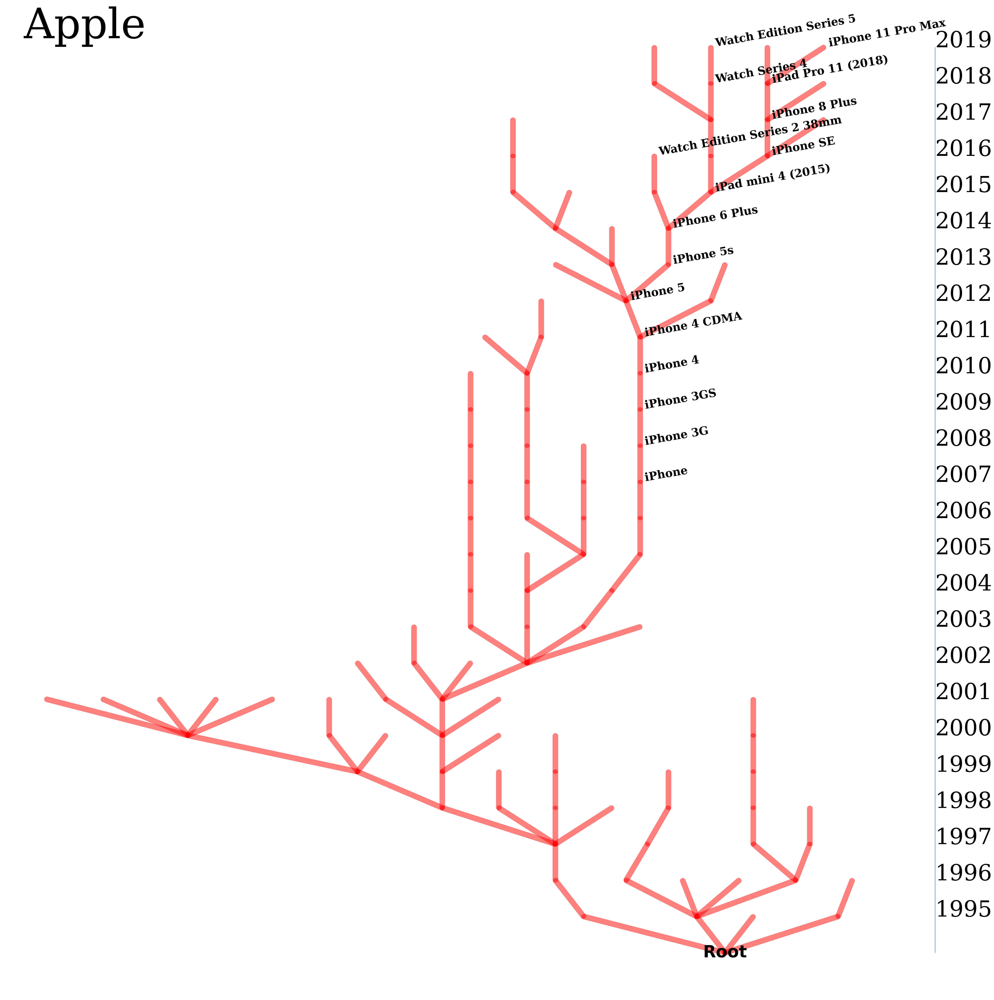

In [ ]:
phylogenetic_tree_Single_firm(G,Node_list,"arc3",20,"Apple Mobile Product paper",False,"Apple")

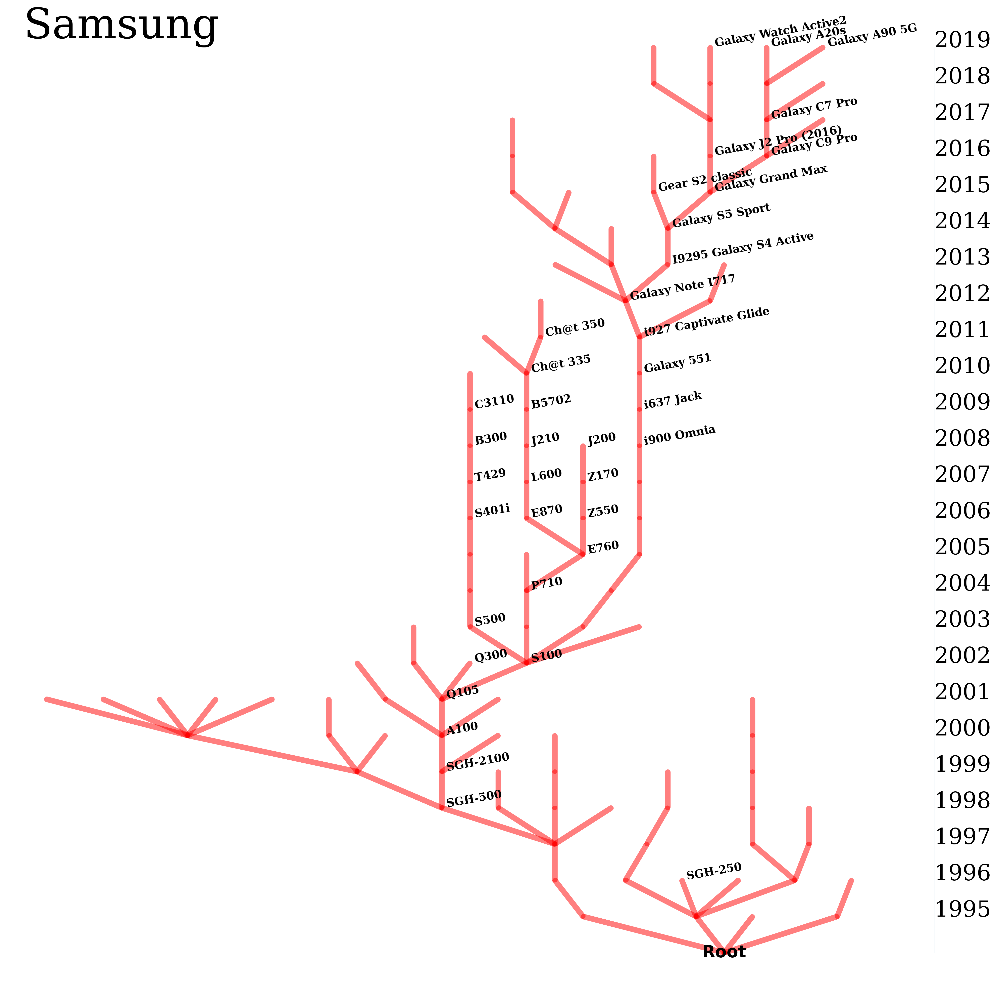

In [ ]:
phylogenetic_tree_Single_firm(G,Node_list,"arc3",20,"Samsung Mobile Product paper",False,"Samsung")

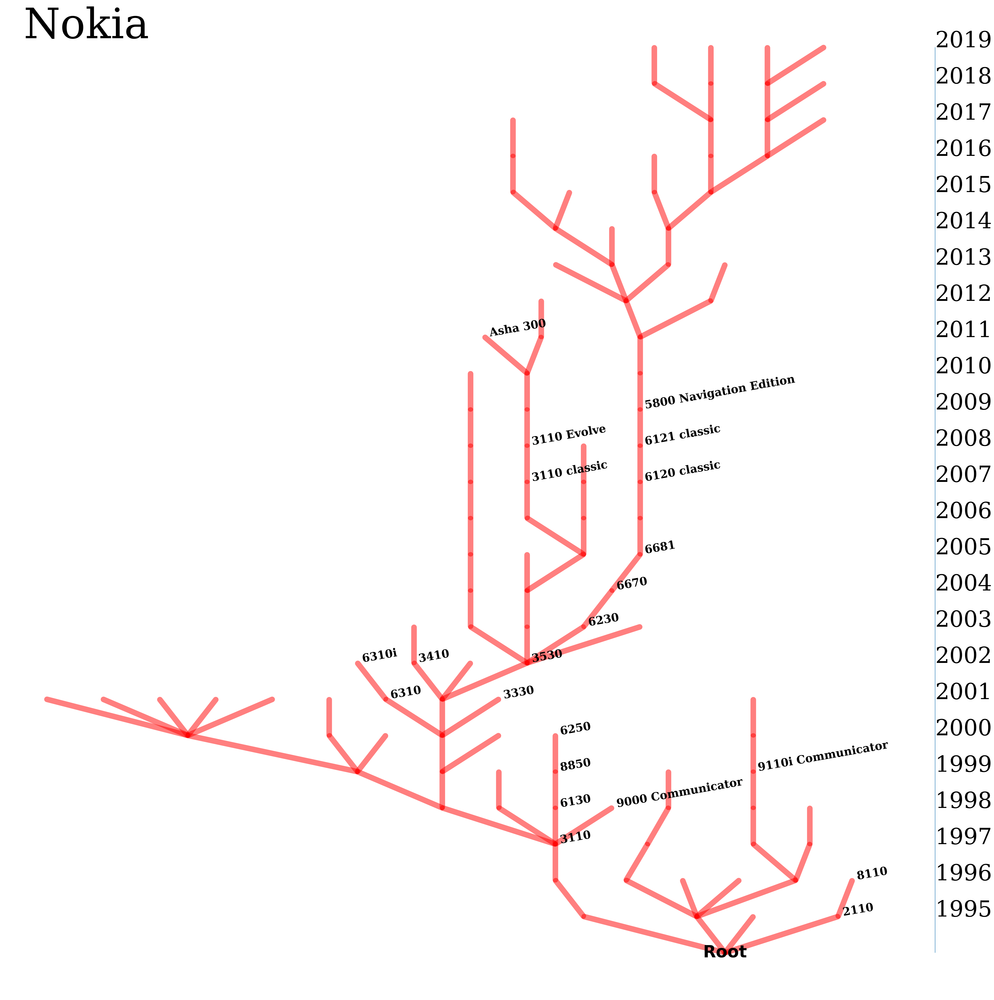

In [ ]:
phylogenetic_tree_Single_firm(G,Node_list,"arc3",20,"Nokia Mobile Product paper",False,"Nokia")

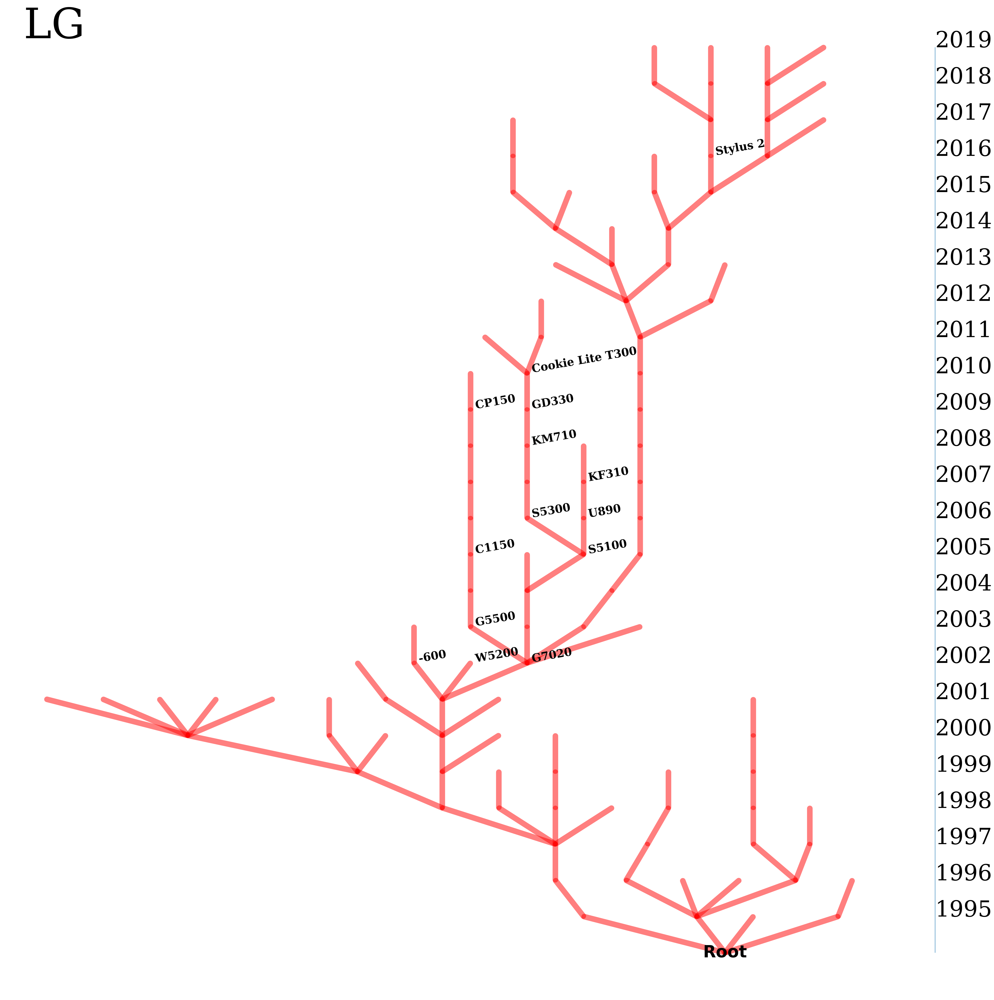

In [ ]:
phylogenetic_tree_Single_firm(G,Node_list,"arc3",20,"LG Mobile Product paper",False,"LG")

# Robustness check

## Euclidean

In [ ]:
df=pd.read_csv(input_directory+"/220503_Taxa_euclidean.csv")
vectors=np.load(input_directory+"/220503_Taxa_euclidean_vector.npy")

df["vector"]=list(vectors)
df.head()

Taxa_list=[]

for i in range(len(df)):
  temp_id=i
  temp_name=df.loc[i,"name"]
  temp_year=df.loc[i,"year"]
  temp_representative=df.loc[i,"representative"]
  temp_representative_vector=df.loc[i,"vector"]
  Taxa_list.append(TAXON(temp_id,temp_name,temp_year))
  Taxa_list[-1].representative=temp_representative
  Taxa_list[-1].representative_vector=temp_representative_vector
  #Taxa_list[-1].products=[item.strip() for item in df.loc[i,"products"][1:-1].split(",")]
  Taxa_list[-1].products=[item.strip() for item in df.loc[i,"product_list"][1:-1].split(",")]

# Matching Evolutionary Relationship
for taxon in tqdm(Taxa_list):
  taxon.ancestor=Ancestor_Descendant_Single_adjacent_year(taxon,Taxa_list)
  #taxon.ancestor=Ancestor_Descendant_Single(taxon,Taxa_list)

for ancestor in Taxa_list:
  temp_list=[]
  for descendant in Taxa_list:
    if descendant.ancestor==ancestor:
      temp_list.append(descendant)
  ancestor.descendants=temp_list

temp_title="GSMArena mobile product paper"

Root=TAXON(-1,"root",1994)
Root.representative="root"
t_root = TreeNode(Root)

Node_list=[]
for taxon in Taxa_list:
  Node_list.append(TreeNode(taxon))

temp_list=[]
for Node in Node_list:
  if Node.taxon.year==1995:
    temp_list.append(Node)

t_root.child=temp_list
Node_list.insert(0,t_root)

for Node in tqdm(Node_list):
  if Node.taxon.year>=1995:
    Node.child=[]
    for descendant in Node.taxon.descendants:
      for Node_j in Node_list:
        if descendant.name==Node_j.taxon.name:
          Node.child.append(Node_j)

myTree = Tree(t_root)
myTree.DFT_preorder()

for node in Node_list:
  myTree.pos[node]=(myTree.pos[node][0],myTree.pos[node][1]-myTree.pos[node][0]*10)

G=nx.DiGraph()
temp_threshold=0
for node in Node_list:
  G.add_node(node.taxon.name)
  for temp_child in node.child:
    G.add_node(temp_child.taxon.name)
    G.add_edge(node.taxon.name,temp_child.taxon.name)

  0%|          | 0/139 [00:00<?, ?it/s]

  0%|          | 0/140 [00:00<?, ?it/s]

 root
-- Ericsson GH 337
-- Ericsson GH 388
---- Samsung SGH-250
---- Bosch Com 738
------ Motorola SlimLite
-------- Motorola cd920
---------- Mitsubishi Trium Galaxy
------------ Sagem MC 936
------------ Mitsubishi Trium fx
---------- Samsung SGH-2100
------------ Samsung A100
-------------- Samsung A400
---------------- Samsung A500
---------- Maxon MX-6814
---------- Maxon MX-3204
------------ Philips Genie 2000
-------------- Ericsson T66
---------------- Motorola C300
------------------ Siemens Xelibri 4
---------------- Samsung S100
------------------ Motorola V220
-------------------- NEC N160
---------------------- LG C1150
------------------------ Samsung C400
-------------------------- Samsung C260
---------------------------- Samsung B300
------------------------------ Samsung E215
-------------------------------- Micromax X235
-------------------- Haier V6000
-------------------- Motorola V400p
---------------------- LG S5100
------------------------ Samsung E870
--------

In [ ]:
# default // input_layout = dot inverse
# input_layout_dict = {
    #'spring': nx.spring_layout(G),
    #'spectral':nx.spectral_layout(G),
    #'shell':nx.shell_layout(G),
    #'circular':nx.circular_layout(G),
    #'kamada_kawai':nx.kamada_kawai_layout(G),
    #'random':nx.random_layout(G),
    #'neato':graphviz_layout(G, prog="neato",root='root'),
    #"twopi":graphviz_layout(G, prog="twopi",root='root'),
    #"dot":graphviz_layout(G, prog="dot",root='root'),
    #"fdp":graphviz_layout(G, prog="fdp",root='root'),
    #"sfdp":graphviz_layout(G, prog="sfdp",root='root'),
    #"circo":graphviz_layout(G, prog="circo",root='root')}

def phylogenetic_tree_Single(input_G,input_Node_list,input_style,input_lw,input_temp_title,name_mode,input_labels_list):
  pos1=graphviz_layout(input_G, prog="dot",root='root')
  temp_pos=pos1
  pos1={}
  for key in list(temp_pos.keys()):
    pos1[key]=[0,0]
    pos1[key][0]=(temp_pos[key][0])
    pos1[key][1]=(-temp_pos[key][1])
  fig = plt.figure(figsize=(50,50))
  ax=plt.subplot(111)
  nx.draw_networkx_nodes(input_G,pos=pos1,node_color="red",alpha=0.5,node_size=0)
  nx.draw_networkx_nodes(input_G,pos=pos1,node_color="red",nodelist=["root"],alpha=1)

  # root node의 후손 연결해주기
  for temp_child in input_Node_list[0].child:
    temp_edge=(input_Node_list[0].taxon.name,temp_child.taxon.name)
    ax.annotate("",
              xy=(pos1[temp_child.taxon.name][0],pos1[temp_child.taxon.name][1]),
              xytext=(pos1[input_Node_list[0].taxon.name][0],pos1[input_Node_list[0].taxon.name][1]),
              arrowprops=dict(
                            arrowstyle="-",
                            lw=input_lw,
                            connectionstyle=input_style,
                            #arrowstyle="wedge",
                            color="red",
                            alpha=0.5
                            )
                  )
  # root node이외의 선조 후손 관계 연결
  for node in input_Node_list:
    if node.taxon.name!="root":
      if node.taxon.descendants:
        for descendant in node.taxon.descendants:
          temp_edge=(node.taxon.name,descendant.name)
          ax.annotate("",
              xy=(pos1[descendant.name][0],pos1[descendant.name][1]),
              xytext=(pos1[node.taxon.name][0],pos1[node.taxon.name][1]),
              arrowprops=dict(
                            arrowstyle="-",
                            lw=input_lw,
                            connectionstyle=input_style,
                            #arrowstyle="wedge",
                            color="red",
                            #alpha=cosine_similarity(node.taxon.representative_vector,descendant.representative_vector)
                            alpha=0.5
                            #alpha=Gower_similarity(node.taxon.representative_vector,descendant.representative_vector,Cat_list)
                            )
                  )

  # year axis
  root_year=int(Node_list[0].taxon.year)
  final_year=int(Node_list[-1].taxon.year)

  year_list=[year for year in range(root_year,final_year+1)]
  temp_y_min=min([pos1[key][1] for key in list(pos1.keys())])
  temp_y_max=max([pos1[key][1] for key in list(pos1.keys())])
  temp_y_list=sorted(list(set([pos1[key][1] for key in list(pos1.keys())])))

  temp_x_min=min([pos1[key][0] for key in list(pos1.keys())])
  temp_x_max=max([pos1[key][0] for key in list(pos1.keys())])
  temp_x_list=sorted(list(set([pos1[key][0] for key in list(pos1.keys())])))


  ax.vlines(temp_x_max*1.1,temp_y_min,temp_y_max)
  for i in range(len(year_list[1:])):
    ax.text(
        temp_x_max*1.1,
        temp_y_list[i+1],
        #temp_y_min+(i+1)*((temp_y_max-temp_y_min)/len(year_list)),
        year_list[i+1],
        fontsize=80
    )

  ax.spines["top"].set_visible(False)
  ax.spines["left"].set_visible(False)
  ax.spines["right"].set_visible(False)
  ax.spines["bottom"].set_visible(False)


  # color bar

  # color bar
  #purple_list=["Micromax X235","Samsung S500","Haier V100","LG C1150","Samsung C400","Samsung C260","Samsung B300","Samsung E215"]
  purple_list=["2003_0","2004_0","2005_1","2006_4","2007_3","2008_1","2009_4","2010_1","2009_2","2008_3","2006_3","2008_2","2004_1","2003_1","2004_5"]
  #"2004_2","2005_2","2006_1","2007_1","2008_2","2009_3","2009_1","2004_1","2005_3","2009_2","2003_1","2004_5","2006_3","2008_3"]


  # Pseudo Smartphone
  #brown_list=["LG Cookie Lite T300","Celkon C777","Celkon C504","Celkon A9+","Nokia C3-01 Gold Edition"]
  brown_list=["2010_2","2011_2","2012_3","2010_3","2011_1"]

  #green_list=["Samsung S100",'Motorola A925',"Qtek S100","Motorola A728","HTC P4350","HTC P3350","Samsung i900 Omnia","Samsung B7330 OmniaPRO","Motorola XT720 MOTOROI","Motorola PRO+","Samsung Rugby Smart I847"]
  green_list=["2013_3","2004_3","2005_0","2006_2","2007_0","2008_0","2009_0","2010_0","2011_0","2012_0"]
  #,"2013_0"]

  #blue_list=["Xiaomi Mi CC9e", "Energizer Ultimate U650S", "BLU View 1", "Samsung Galaxy Watch Active2"]
  blue_list=["2019_0","2019_3","2019_1","2019_2","2019_4"]

  #red_list=['Huawei P9 lite mini', 'Huawei MediaPad M5 8', 'Huawei Watch 2 2018',"Xiaomi Redmi 3s Prime","ZTE nubia N3","Gionee S11"]
  red_list=["2017_2","2018_4","2017_4","2018_1","2016_2"]


  # labeling
  if name_mode:
    for node in input_Node_list:
      if node.taxon.name!="root":
        ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],node.taxon.name,rotation=30,fontsize=50)

    plt.tight_layout()
    plt.savefig(output_directory+"/"+temp_title+"_Phylogenetic Tree dot inverse_200_wo_label.jpg",dpi=200,transparent=True,bbox_inches="tight")
    plt.savefig(output_directory+"/"+temp_title+"_Phylogenetic Tree dot inverse_300_wo_label.jpg",dpi=300,transparent=True,bbox_inches="tight")

  else:
    # labeling
    for node in input_Node_list:
      if node.taxon.name!="root":
        temp_firm=Counter([product[1:-1].split(" ")[0].strip() for product in node.taxon.products]).most_common(2)
        temp_firm=[x[0] for x in temp_firm]


        temp_list=[]
        temp_sim_list=[]
        for item in node.taxon.products:
          if (item[1:-1].split(" ")[0].strip()) in temp_firm:
            product=[product for product in product_list if product.name==item[1:-1]][0]
            temp_list.append(product)
            temp_sim_list.append(cosine_similarity(product.chromosome_vector,node.taxon.representative_vector))
        temp_label=temp_list[
                              temp_sim_list.index(max(temp_sim_list))
        ]
        temp_label=temp_label.name

        if len(temp_label.split(" "))>=3:
          temp_label=temp_label.split(" ")[0]+"\n"+temp_label.split(" ")[1]+" "+temp_label.split(" ")[2]
        else:
          temp_label=temp_label.split(" ")[0]+"\n"+temp_label.split(" ")[1]

        temp_fontsize=40
        if node.taxon.name in purple_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="purple",fontweight="bold")

        elif node.taxon.name in brown_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="brown",fontweight="bold")
        elif node.taxon.name in green_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="green",fontweight="bold")
        elif node.taxon.name in blue_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="blue",fontweight="bold")
        elif node.taxon.name in red_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="grey",fontweight="bold")

        # 2019 node
        elif node.taxon.year==2019:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold",color="blue")
        elif node.taxon.year==2003:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold",color="black")

        elif not node.taxon.descendants:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold")
        elif len(node.taxon.descendants)>=3:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold")




    nx.draw_networkx_labels(G,pos=pos1,labels={"root":"Root"},font_size=60,font_weight="bold")

  ax.text(0,0,"Euclidean",fontsize=150)
  plt.tight_layout()
  plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_200_w_label.jpg",dpi=200,transparent=True,bbox_inches="tight")
  plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_600_w_label.jpg",dpi=600,transparent=True,bbox_inches="tight")

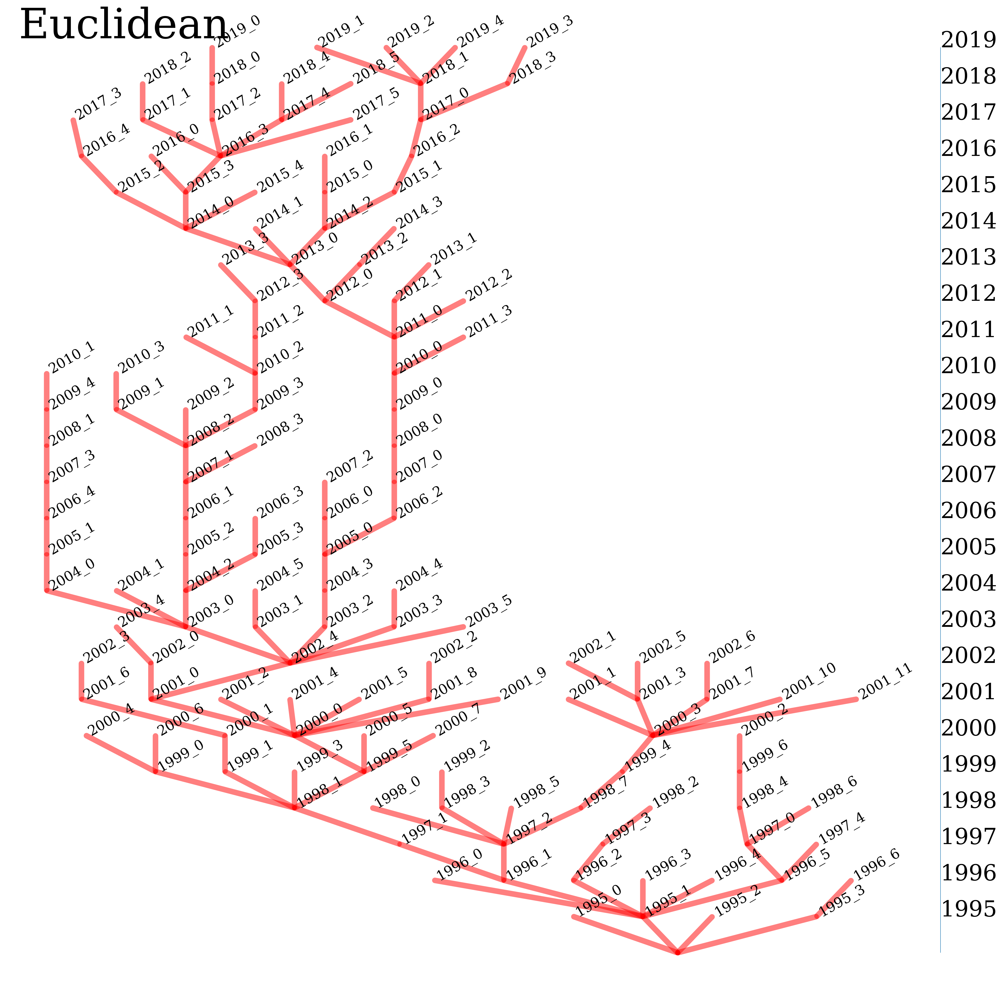

In [ ]:
phylogenetic_tree_Single(G,Node_list,"arc3",20,"220503_Mobile Product paper_euclidean_Numer",True,[taxon.name for taxon in Taxa_list])

In [ ]:
for taxon in Taxa_list:
  print(taxon.representative)

Ericsson GH 337
Ericsson GH 388
Ericsson GA 318
Nokia 2110
Samsung SGH-250
Bosch Com 738
Philips Fizz
Ericsson GH 688
Ericsson GA 628
Ericsson GS 18
Nokia 8110
Motorola StarTAC 75
Motorola SlimLite
Sony CMD Z1 plus
Philips Diga
Ericsson GF 768
Motorola d520
Motorola cd920
alcatel OT Max
alcatel OT View
Sagem MC 820
Siemens S11
Nokia 9000 Communicator
Nokia 6150
Mitsubishi Trium Galaxy
Samsung SGH-2100
Motorola M3888
Maxon MX-6814
Nokia 8210
Maxon MX-3204
Siemens C25
Philips Genie 2000
Samsung A100
alcatel OT Club db
Motorola V.box(V100)
Sagem MC 936
Ericsson R310s
Mitsubishi Trium fx
Motorola Talkabout T2288
Ericsson T66
Sony CMD J7
Sagem MW 3042
Mitsubishi Trium Eclipse
Sagem MW 3020
Motorola Talkabout T192
Samsung A400
Motorola V66
NEC DB6000
Sendo S200
Nokia 3330
Siemens SL42
Motorola C300
LG G7020
LG LG-500
Samsung A500
Samsung S100
Philips Fisio 820
Nokia 7210
Motorola V220
Amoi A9B
Nokia 7200
Siemens Xelibri 5
Siemens Xelibri 4
Innostream INNO 100
NEC N160
Haier V6000
Motorola V4

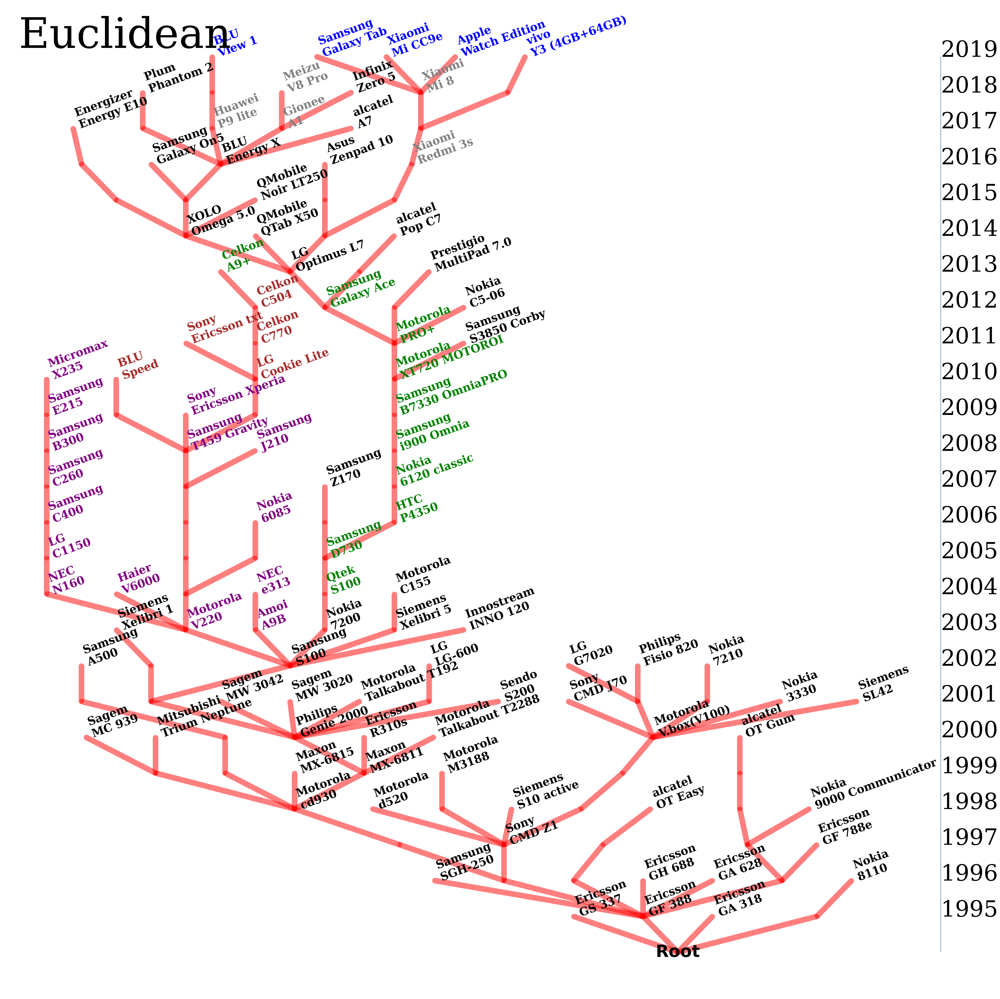

In [ ]:
phylogenetic_tree_Single(G,Node_list,"arc3",20,"220503_Mobile Product paper_euclidean",False,[taxon.name for taxon in Taxa_list])

## Cosine

In [ ]:
df=pd.read_csv(input_directory+"/220503_Taxa_cosine.csv")
vectors=np.load(input_directory+"/220503_Taxa_cosine_vector.npy")

df["vector"]=list(vectors)
df.head()

Taxa_list=[]

for i in range(len(df)):
  temp_id=i
  temp_name=df.loc[i,"name"]
  temp_year=df.loc[i,"year"]
  temp_representative=df.loc[i,"representative"]
  temp_representative_vector=df.loc[i,"vector"]
  Taxa_list.append(TAXON(temp_id,temp_name,temp_year))
  Taxa_list[-1].representative=temp_representative
  Taxa_list[-1].representative_vector=temp_representative_vector
  #Taxa_list[-1].products=[item.strip() for item in df.loc[i,"products"][1:-1].split(",")]
  Taxa_list[-1].products=[item.strip() for item in df.loc[i,"product_list"][1:-1].split(",")]

# Matching Evolutionary Relationship
for taxon in tqdm(Taxa_list):
  taxon.ancestor=Ancestor_Descendant_Single_adjacent_year(taxon,Taxa_list)
  #taxon.ancestor=Ancestor_Descendant_Single(taxon,Taxa_list)

for ancestor in Taxa_list:
  temp_list=[]
  for descendant in Taxa_list:
    if descendant.ancestor==ancestor:
      temp_list.append(descendant)
  ancestor.descendants=temp_list

temp_title="GSMArena mobile product paper"

Root=TAXON(-1,"root",1994)
Root.representative="root"
t_root = TreeNode(Root)

Node_list=[]
for taxon in Taxa_list:
  Node_list.append(TreeNode(taxon))

temp_list=[]
for Node in Node_list:
  if Node.taxon.year==1995:
    temp_list.append(Node)

t_root.child=temp_list
Node_list.insert(0,t_root)

for Node in tqdm(Node_list):
  if Node.taxon.year>=1995:
    Node.child=[]
    for descendant in Node.taxon.descendants:
      for Node_j in Node_list:
        if descendant.name==Node_j.taxon.name:
          Node.child.append(Node_j)

myTree = Tree(t_root)
myTree.DFT_preorder()

for node in Node_list:
  myTree.pos[node]=(myTree.pos[node][0],myTree.pos[node][1]-myTree.pos[node][0]*10)

G=nx.DiGraph()
temp_threshold=0
for node in Node_list:
  G.add_node(node.taxon.name)
  for temp_child in node.child:
    G.add_node(temp_child.taxon.name)
    G.add_edge(node.taxon.name,temp_child.taxon.name)

  0%|          | 0/104 [00:00<?, ?it/s]

  0%|          | 0/105 [00:00<?, ?it/s]

 root
-- Ericsson GH 388
---- Bosch Com 738
------ Sony CMD Z1 plus
-------- alcatel OT COM
-------- Motorola StarTAC 130
---------- Samsung SGH-2100
------------ Samsung N100
-------------- Motorola V60
---------------- Samsung T200
------------------ Amoi A9B
-------------------- Haier V100
---------------------- LG C1150
------------------------ Samsung C400
-------------------------- Samsung C260
---------------------------- Samsung B300
------------------------------ Samsung E215
------------------ Motorola V303
-------------------- Samsung P710
---------------------- Telit C1000
---------------------- LG S5100
------------------------ Samsung Z550
-------------------------- Samsung L760
------------------------ Samsung E870
-------------------------- Samsung L600
---------------------------- Samsung J210
------------------------------ LG GD330
-------------------------------- LG Flick T320
-------------------------------- LG GB280
---------------------------------- Samsung Ch@t 5

In [ ]:
# default // input_layout = dot inverse
# input_layout_dict = {
    #'spring': nx.spring_layout(G),
    #'spectral':nx.spectral_layout(G),
    #'shell':nx.shell_layout(G),
    #'circular':nx.circular_layout(G),
    #'kamada_kawai':nx.kamada_kawai_layout(G),
    #'random':nx.random_layout(G),
    #'neato':graphviz_layout(G, prog="neato",root='root'),
    #"twopi":graphviz_layout(G, prog="twopi",root='root'),
    #"dot":graphviz_layout(G, prog="dot",root='root'),
    #"fdp":graphviz_layout(G, prog="fdp",root='root'),
    #"sfdp":graphviz_layout(G, prog="sfdp",root='root'),
    #"circo":graphviz_layout(G, prog="circo",root='root')}

def phylogenetic_tree_Single(input_G,input_Node_list,input_style,input_lw,input_temp_title,name_mode,input_labels_list):
  pos1=graphviz_layout(input_G, prog="dot",root='root')
  temp_pos=pos1
  pos1={}
  for key in list(temp_pos.keys()):
    pos1[key]=[0,0]
    pos1[key][0]=(temp_pos[key][0])
    pos1[key][1]=(-temp_pos[key][1])
  fig = plt.figure(figsize=(50,50))
  ax=plt.subplot(111)
  nx.draw_networkx_nodes(input_G,pos=pos1,node_color="red",alpha=0.5,node_size=0)
  nx.draw_networkx_nodes(input_G,pos=pos1,node_color="red",nodelist=["root"],alpha=1)

  # root node의 후손 연결해주기
  for temp_child in input_Node_list[0].child:
    temp_edge=(input_Node_list[0].taxon.name,temp_child.taxon.name)
    ax.annotate("",
              xy=(pos1[temp_child.taxon.name][0],pos1[temp_child.taxon.name][1]),
              xytext=(pos1[input_Node_list[0].taxon.name][0],pos1[input_Node_list[0].taxon.name][1]),
              arrowprops=dict(
                            arrowstyle="-",
                            lw=input_lw,
                            connectionstyle=input_style,
                            #arrowstyle="wedge",
                            color="red",
                            alpha=0.5
                            )
                  )
  # root node이외의 선조 후손 관계 연결
  for node in input_Node_list:
    if node.taxon.name!="root":
      if node.taxon.descendants:
        for descendant in node.taxon.descendants:
          temp_edge=(node.taxon.name,descendant.name)
          ax.annotate("",
              xy=(pos1[descendant.name][0],pos1[descendant.name][1]),
              xytext=(pos1[node.taxon.name][0],pos1[node.taxon.name][1]),
              arrowprops=dict(
                            arrowstyle="-",
                            lw=input_lw,
                            connectionstyle=input_style,
                            #arrowstyle="wedge",
                            color="red",
                            #alpha=cosine_similarity(node.taxon.representative_vector,descendant.representative_vector)
                            alpha=0.5
                            #alpha=Gower_similarity(node.taxon.representative_vector,descendant.representative_vector,Cat_list)
                            )
                  )

  # year axis
  root_year=int(Node_list[0].taxon.year)
  final_year=int(Node_list[-1].taxon.year)

  year_list=[year for year in range(root_year,final_year+1)]
  temp_y_min=min([pos1[key][1] for key in list(pos1.keys())])
  temp_y_max=max([pos1[key][1] for key in list(pos1.keys())])
  temp_y_list=sorted(list(set([pos1[key][1] for key in list(pos1.keys())])))

  temp_x_min=min([pos1[key][0] for key in list(pos1.keys())])
  temp_x_max=max([pos1[key][0] for key in list(pos1.keys())])
  temp_x_list=sorted(list(set([pos1[key][0] for key in list(pos1.keys())])))


  ax.vlines(temp_x_max*1.1,temp_y_min,temp_y_max)
  for i in range(len(year_list[1:])):
    ax.text(
        temp_x_max*1.1,
        temp_y_list[i+1],
        #temp_y_min+(i+1)*((temp_y_max-temp_y_min)/len(year_list)),
        year_list[i+1],
        fontsize=80
    )

  ax.spines["top"].set_visible(False)
  ax.spines["left"].set_visible(False)
  ax.spines["right"].set_visible(False)
  ax.spines["bottom"].set_visible(False)


  # color bar

  # color bar
  #purple_list=["Micromax X235","Samsung S500","Haier V100","LG C1150","Samsung C400","Samsung C260","Samsung B300","Samsung E215"]
  purple_list=["2003_0","2004_0","2005_2","2006_2","2007_3","2008_1","2009_1","2004_1","2005_4","2007_0","2003_1","2005_1"]
  #"2003_1","2004_1","2005_3","2006_1","2007_1","2008_2","2009_3","2010_2"]


  # Pseudo Smartphone
  #brown_list=["LG Cookie Lite T300","Celkon C777","Celkon C504","Celkon A9+","Nokia C3-01 Gold Edition"]
  brown_list=["2010_1","2011_1","2012_1","2003_2"]

  #green_list=["Samsung S100",'Motorola A925',"Qtek S100","Motorola A728","HTC P4350","HTC P3350","Samsung i900 Omnia","Samsung B7330 OmniaPRO","Motorola XT720 MOTOROI","Motorola PRO+","Samsung Rugby Smart I847"]
  green_list=['2004_2',"2005_0","2006_3","2007_2","2008_0","2009_0","2010_0","2011_0","2012_2"]
  #,"2013_0","2013_2"]

  #blue_list=["Xiaomi Mi CC9e", "Energizer Ultimate U650S", "BLU View 1", "Samsung Galaxy Watch Active2"]
  blue_list=["2019_0","2019_3","2019_1","2019_2","2019_4"]

  #red_list=['Huawei P9 lite mini', 'Huawei MediaPad M5 8', 'Huawei Watch 2 2018',"Xiaomi Redmi 3s Prime","ZTE nubia N3","Gionee S11"]
  red_list=["2018_0","2018_3","2016_2","2017_2","2017_1"]


  # labeling
  if name_mode:
    for node in input_Node_list:
      if node.taxon.name!="root":
        ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],node.taxon.name,rotation=30,fontsize=50)

    plt.tight_layout()
    plt.savefig(output_directory+"/"+temp_title+"_Phylogenetic Tree dot inverse_200_wo_label.jpg",dpi=200,transparent=True,bbox_inches="tight")
    plt.savefig(output_directory+"/"+temp_title+"_Phylogenetic Tree dot inverse_300_wo_label.jpg",dpi=300,transparent=True,bbox_inches="tight")

  else:
    # labeling
    for node in input_Node_list:
      if node.taxon.name!="root":
        temp_firm=Counter([product[1:-1].split(" ")[0].strip() for product in node.taxon.products]).most_common(2)
        temp_firm=[x[0] for x in temp_firm]


        temp_list=[]
        temp_sim_list=[]
        for item in node.taxon.products:
          if (item[1:-1].split(" ")[0].strip()) in temp_firm:
            product=[product for product in product_list if product.name==item[1:-1]][0]
            temp_list.append(product)
            temp_sim_list.append(cosine_similarity(product.chromosome_vector,node.taxon.representative_vector))
        temp_label=temp_list[
                              temp_sim_list.index(max(temp_sim_list))
        ]
        temp_label=temp_label.name

        if len(temp_label.split(" "))>=3:
          temp_label=temp_label.split(" ")[0]+"\n"+temp_label.split(" ")[1]+" "+temp_label.split(" ")[2]
        else:
          temp_label=temp_label.split(" ")[0]+"\n"+temp_label.split(" ")[1]

        temp_fontsize=40
        if node.taxon.name in purple_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="purple",fontweight="bold")

        elif node.taxon.name in brown_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="brown",fontweight="bold")
        elif node.taxon.name in green_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="green",fontweight="bold")
        elif node.taxon.name in blue_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="blue",fontweight="bold")
        elif node.taxon.name in red_list:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,color="grey",fontweight="bold")

        # 2019 node
        elif node.taxon.year==2019:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold",color="blue")
        elif node.taxon.year==2003:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold",color="black")

        elif not node.taxon.descendants:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold")
        elif len(node.taxon.descendants)>=3:
          ax.text(pos1[node.taxon.name][0],pos1[node.taxon.name][1],temp_label,rotation=20,fontsize=temp_fontsize,fontweight="bold")




    nx.draw_networkx_labels(G,pos=pos1,labels={"root":"Root"},font_size=60,font_weight="bold")

  ax.text(0,0,"Cosine",fontsize=150)
  plt.tight_layout()
  plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_200_w_label.jpg",dpi=200,transparent=True,bbox_inches="tight")
  plt.savefig(output_directory+"/"+input_temp_title+"_Phylogenetic Tree dot inverse_600_w_label.jpg",dpi=600,transparent=True,bbox_inches="tight")

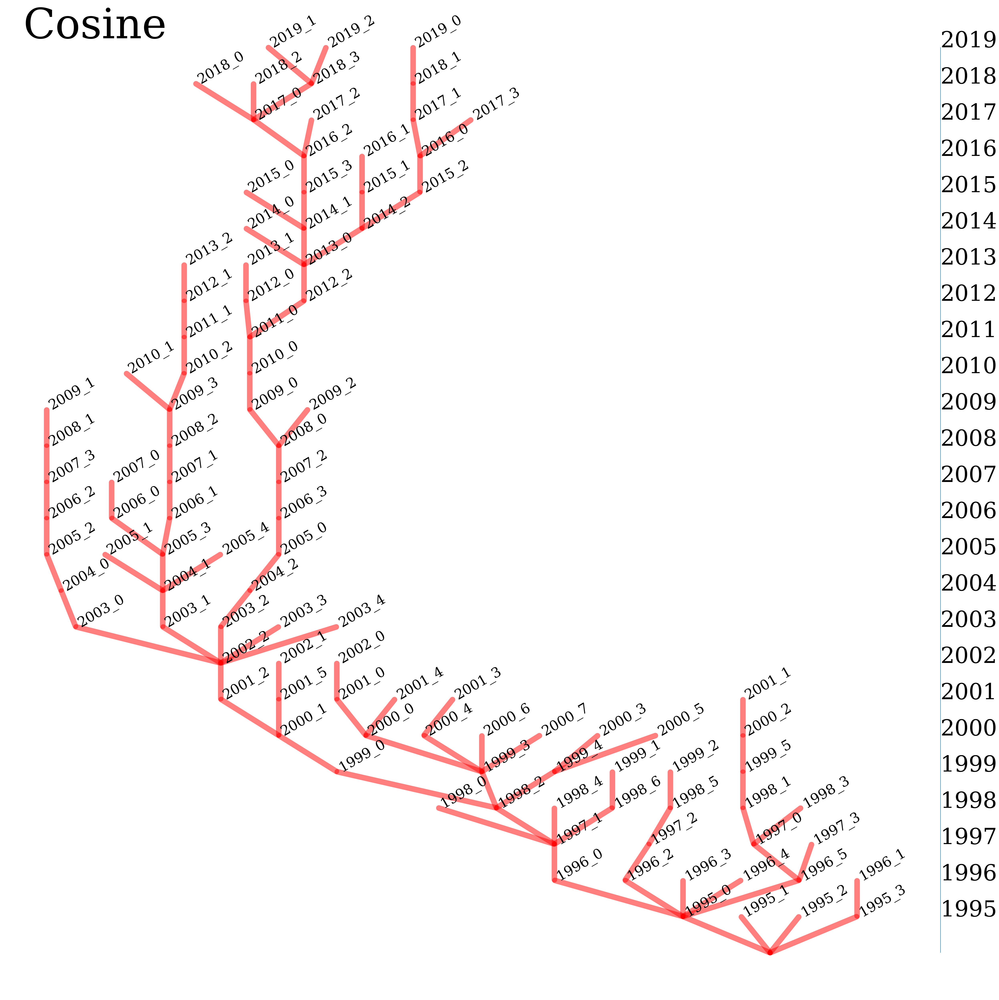

In [ ]:
phylogenetic_tree_Single(G,Node_list,"arc3",20,"220503_Mobile Product paper_cosine_Numer",True,[taxon.name for taxon in Taxa_list])

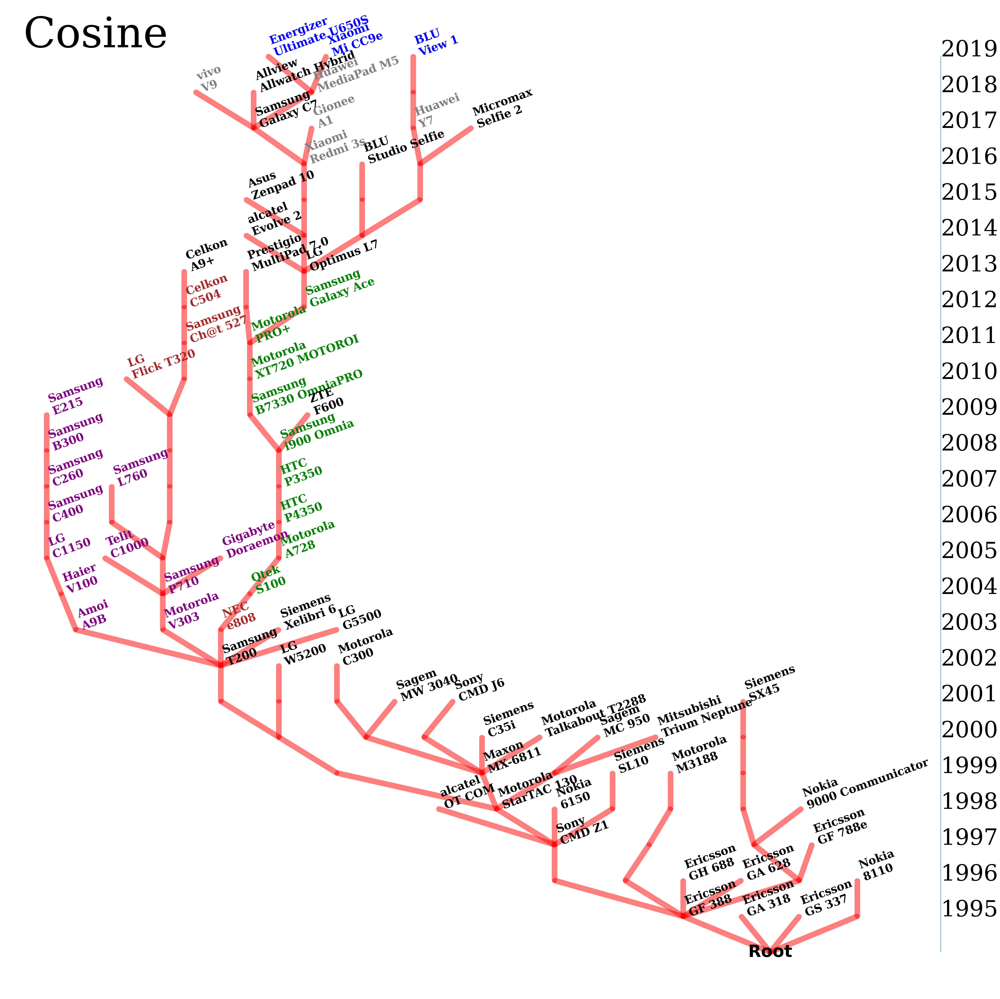

In [ ]:
phylogenetic_tree_Single(G,Node_list,"arc3",20,"220503_Mobile Product paper_cosine",False,[taxon.name for taxon in Taxa_list])